<a href="https://colab.research.google.com/github/roh1tns/Basic-GAN/blob/main/Advanced_GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [21]:
# Importig the libraries
import torch, torchvision, PIL, os, pdb
from torch import nn
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

def show(tensor, num=25, wandbactive=0, name=''):
  data = tensor.detach().cpu()
  grid = make_grid(data[:num], nrow=5).permute(1, 2, 0)

  if (wandbactive==1):
    wandb.log({name:wandb.Image(grid.numpy().clip(0, 1))})

  plt.imshow(grid.clip(0, 1))
  plt.show()


## Hyperparameters and general parameters
n_epochs = 10000
batch_size = 128
lr = 1e-4
z_dim = 200
device = 'cuda'

cur_step = 0
crit_cycles = 5
gen_losses = []
crit_losses = []
show_step = 35
save_step = 35

wandbact = 1 # Yes we want to track stats thru weights and biases


In [22]:
!pip install wandb -qqq
import wandb
wandb.login(key='ea415b834084f3f3f8f1cd88d94b209cd5b0a1e2')

wandb: WARNING Calling wandb.login() after wandb.init() has no effect.


True

In [23]:
%%capture
experiment_name = wandb.util.generate_id()

myrun = wandb.init(
    project = "wgan",
    group = experiment_name,
    config = {
        "optimizer": "adam",
        "model": "wgan gp",
        "epoch": "1000",
        "batch_size": 128
    }
)

config = wandb.config


In [24]:

print(experiment_name)

90vxenlq


In [25]:
# Generator model

class Generator(nn.Module):
  def __init__(self, z_dim=64, d_dim=16):
    super(Generator, self).__init__()
    self.z_dim = z_dim

    self.gen = nn.Sequential(
        # ConvTranspose2D: in_channels, out_channels, kernel_size, stride=1, padding=0
        # Calculate new width and height: (n-1) * stride - 2*padding + ks (ConvTranspose2D)
        # begin with a 1x1 image with z_dim number of channels (200)
        nn.ConvTranspose2d(z_dim, d_dim * 32, 4, 1, 0), ## 4x4 (ch: 200 -> 512)
        nn.BatchNorm2d(d_dim * 32),
        nn.ReLU(True),

        nn.ConvTranspose2d(d_dim*32, d_dim * 16, 4, 2, 1), # 8x8 (ch: 512 -> 256)
        nn.BatchNorm2d(d_dim * 16),
        nn.ReLU(True),

        nn.ConvTranspose2d(d_dim * 16, d_dim * 8, 4, 2, 1), #16x16 (ch: 256 -> 128)
        nn.BatchNorm2d(d_dim * 8),
        nn.ReLU(True),
        
        nn.ConvTranspose2d(d_dim * 8, d_dim * 4, 4, 2, 1), #32x32 (ch: 128 -> 64)
        nn.BatchNorm2d(d_dim * 4),
        nn.ReLU(True),
        
        nn.ConvTranspose2d(d_dim * 4, d_dim * 2, 4, 2, 1), #64x64 (ch: 64 -> 32)
        nn.BatchNorm2d(d_dim * 2),
        nn.ReLU(True),

        nn.ConvTranspose2d(d_dim * 2, 3, 4, 2, 1), #128x128 (ch: 32 -> 3)
        nn.Tanh() # Produce result in range -1 to 1
    )

  def forward(self, noise):
    x = noise.view(len(noise), self.z_dim, 1, 1) # 128(batch size) x 200(channels) x 1 x 1
    return self.gen(x)

In [26]:
def gen_noise(number, z_dim, device='cuda'):
  return torch.randn(number, z_dim, device=device)

**nn.Conv2d:** Typically reduces size of the input(we increase number of channels to compensate). Used in critic to go from full size image to the prediction (size 1) </br>
<i>new width = (n + 2*pad - ks)//stride + 1</i>
</br>
</br>
**nn.ConvTranspose2d:** Typically increases the size of the input(we reduce the number of channels to compensate). Used in the generator to go from a 1 x 1 noise vector with a number of channels to a full sized image.</br>
<i>new width = (n - 1)*stride - 2*pad + ks</i>
</br>
</br>
pad: padding</br>
stride: the amount by which the kernel is moved in every slide</br>
ks: kernel size</br>
n: old width or height of the image

In [27]:
# CRITIC MODEL


class Critic(nn.Module):
  def __init__(self, d_dim=16):
    super(Critic, self).__init__()

    self.crit = nn.Sequential(
        # Conv2d: in_channels, out_chanels, kernel_size, stride=1, padding=0
        # new width and height: (n + 2*pad - ks)//stride + 1
        # initial image: 128x128, 3 channel
        nn.Conv2d(3, d_dim, 4, 2, 1), # 64 x 64 (ch: 3 -> 16)
        nn.InstanceNorm2d(d_dim),
        nn.LeakyReLU(0.2),

        nn.Conv2d(d_dim, d_dim * 2, 4, 2, 1), # 32x32 (ch: 16 -> 32)
        nn.InstanceNorm2d(d_dim*2),
        nn.LeakyReLU(0.2),

        nn.Conv2d(d_dim * 2, d_dim * 4, 4, 2, 1), # 16x16 (ch: 32 -> 64)
        nn.InstanceNorm2d(d_dim*4),
        nn.LeakyReLU(0.2),

        nn.Conv2d(d_dim * 4, d_dim * 8, 4, 2, 1), # 8x8 (ch: 64 -> 128)
        nn.InstanceNorm2d(d_dim*8),
        nn.LeakyReLU(0.2),

        nn.Conv2d(d_dim * 8, d_dim * 16, 4, 2, 1), # 4x4 (ch: 128 -> 256)
        nn.InstanceNorm2d(d_dim*16),
        nn.LeakyReLU(0.2),

        nn.Conv2d(d_dim * 16, 1, 4, 1, 0), # 1x1 (ch: 256 -> 1)

    )

  def forward(self, image):
    crit_pred = self.crit(image) # 128(batch size) x 1(channels) x 1 x 1
    return crit_pred.view(len(crit_pred), -1) # 128 x 1


In [28]:
# Loading the celebA dataset
import gdown, zipfile
url = "https://drive.google.com/uc?id=1-JkyoNeL6Srw69c1uClGGlABMHaO4riL"
path = 'data/celeba'
download_path = f'{path}/img_align_celeba.zip'

if not os.path.exists(path):
  os.makedirs(path)

gdown.download(url, download_path, quiet=False)

with zipfile.ZipFile(download_path, 'r') as ziphandler:
  ziphandler.extractall(path)


Downloading...
From: https://drive.google.com/uc?id=1-JkyoNeL6Srw69c1uClGGlABMHaO4riL
To: /content/data/celeba/img_align_celeba.zip
100%|██████████| 1.44G/1.44G [00:12<00:00, 114MB/s]


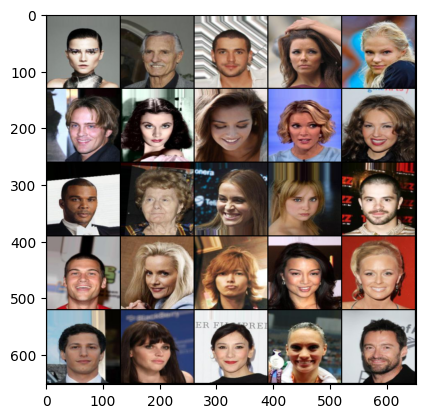

In [29]:
# Dataset, dataloader, declare gen, crit, test dataset

class Dataset(Dataset):
  def __init__(self, path, size=128, lim=10000):
    self.sizes = [size, size]
    items, labels = [], []


    for data in os.listdir(path)[:lim]:
        item = os.path.join(path, data)
        items.append(item)
        labels.append(data)
    self.items = items
    self.labels = labels

  def __len__(self):
    return len(self.items)

  def __getitem__(self, idx):
    data = PIL.Image.open(self.items[idx]).convert('RGB')
    data = np.asarray(torchvision.transforms.Resize(self.sizes)(data))
    data = np.transpose(data, (2, 0, 1)).astype(np.float32)
    data = torch.from_numpy(data).div(255)
    return data, self.labels[idx]

# Dataset
data_path = './data/celeba/img_align_celeba'
ds = Dataset(data_path, size=128, lim=10000)

# DataLader
dataloader = DataLoader(ds, batch_size=batch_size, shuffle=True)

# Models
gen = Generator(z_dim).to(device)
crit = Critic().to(device)

# Optimizers
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(0.5, 0.9))
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(0.5, 0.9))

# wandb
if (wandbact == 1):
  wandb.watch(gen, log_freq=100)
  wandb.watch(crit, log_freq=100)

x, y = next(iter(dataloader))
show(x)

In [30]:
# gradient penalty calculation
def get_gp(real, fake, crit, alpha, gamma=10):
  mix_images = real * alpha + fake * (1-alpha) # 128(bs) x 3 x 128 x 128
  mix_scores = crit(mix_images)

  gradient = torch.autograd.grad(
      inputs = mix_images,
      outputs = mix_scores,
      grad_outputs = torch.ones_like(mix_scores),
      retain_graph = True,
      create_graph = True
  )[0]

  gradient = gradient.view(len(gradient), -1)
  gradient_norm = gradient.norm(2, dim = 1)
  gp = gamma*((gradient_norm-1)**2).mean()
  return gp

In [31]:
# Save and load checkpints
root_path = './data/'

def save_checkpoint(name):
  torch.save({
      'epoch': epoch,
      'model_state_dict': gen.state_dict(),
      'optimizer_state_dict': gen_opt.state_dict()
  }, f'{root_path}G-{name}.pkl')

  torch.save({
      'epoch': epoch,
      'model_state_dict': crit.state_dict(),
      'optimizer_state_dict': crit_opt.state_dict()
  }, f'{root_path}C-{name}.pkl')

  print("Saved Checkpoint")


def load_checkpoint(name):
  checkpoint = torch.load(f"{root_path}G-{name}.pkl")
  gen.load_state_dict(checkpoint['model_state_dict'])
  gen_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  checkpoint = torch.load(f"{root_path}C-{name}.pkl")
  crit.load_state_dict(checkpoint['model_state_dict'])
  crit_opt.load_state_dict(checkpoint['optimizer_state_dict'])

  print("Loaded Checkpoint")


  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  35 35
Saved Checkpoint


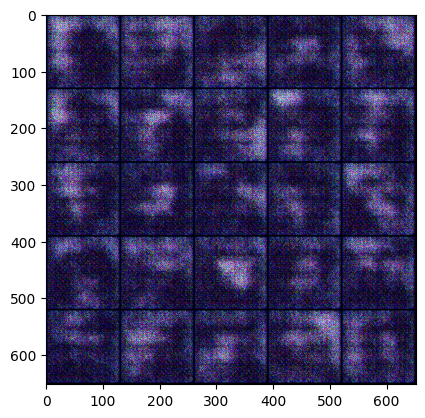

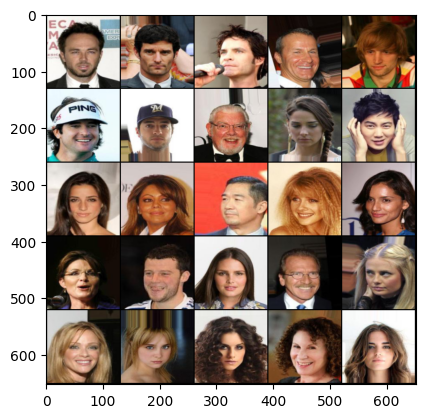

Epoch: 0 : Step 35: Generator loss: 12.145786929343428, Critic loss: -11.991764855725423


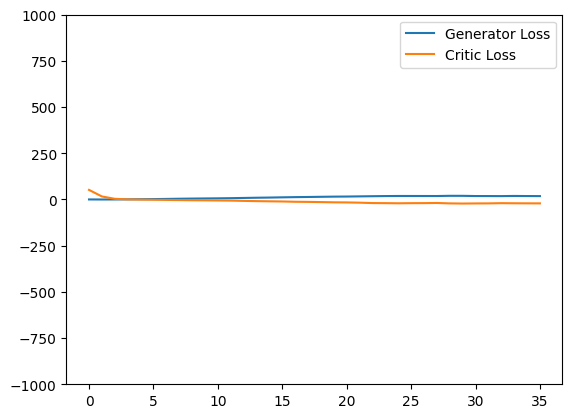

Saving checkpoint:  70 35
Saved Checkpoint


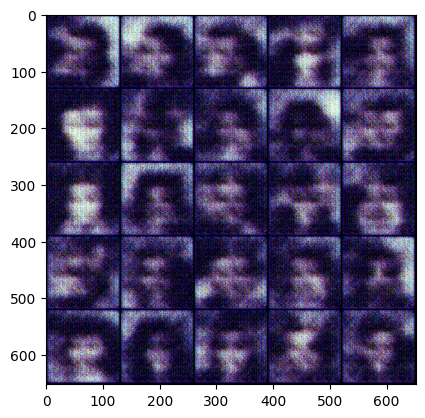

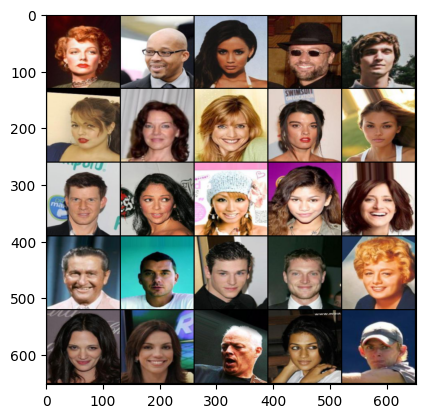

Epoch: 0 : Step 70: Generator loss: 20.918270547049385, Critic loss: -24.153396170479912


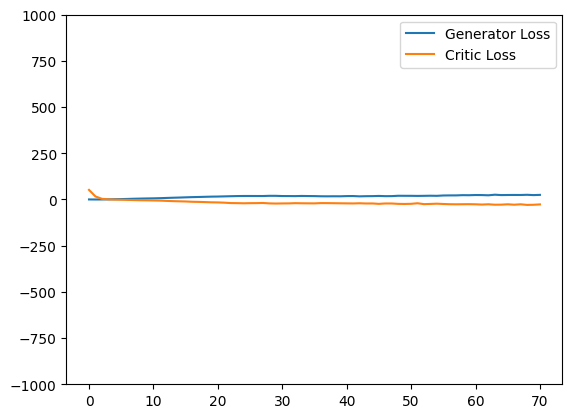

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  105 35
Saved Checkpoint


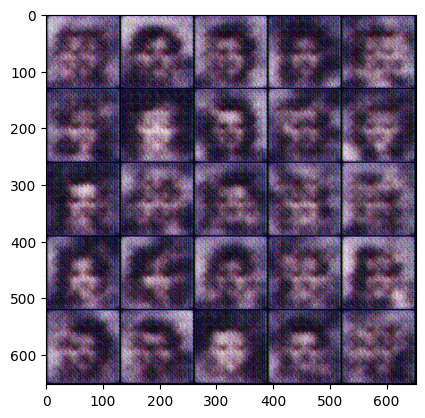

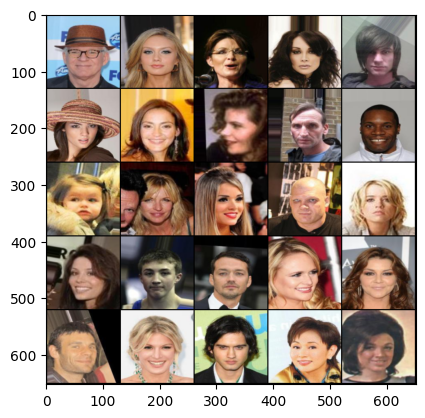

Epoch: 1 : Step 105: Generator loss: 26.289246368408204, Critic loss: -27.231345105852395


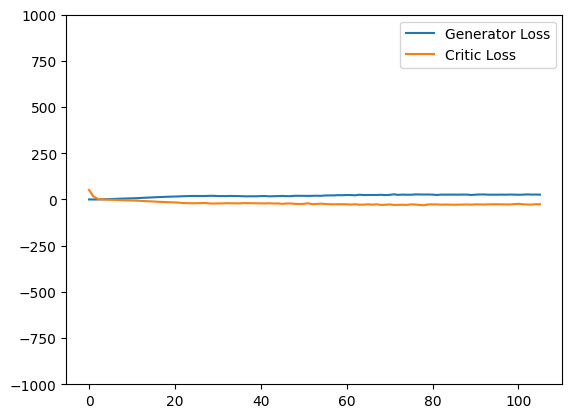

Saving checkpoint:  140 35
Saved Checkpoint


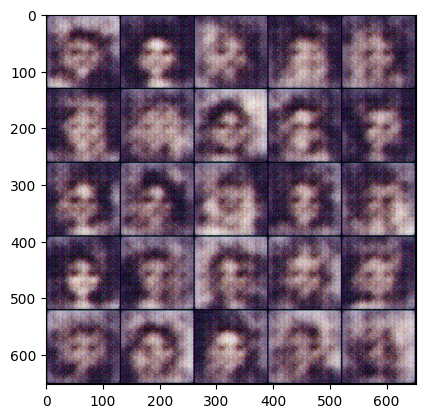

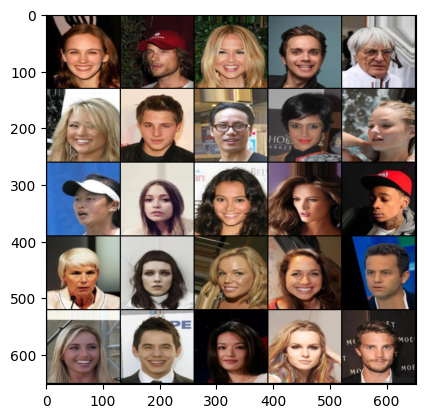

Epoch: 1 : Step 140: Generator loss: 24.844948305402482, Critic loss: -22.210797222682405


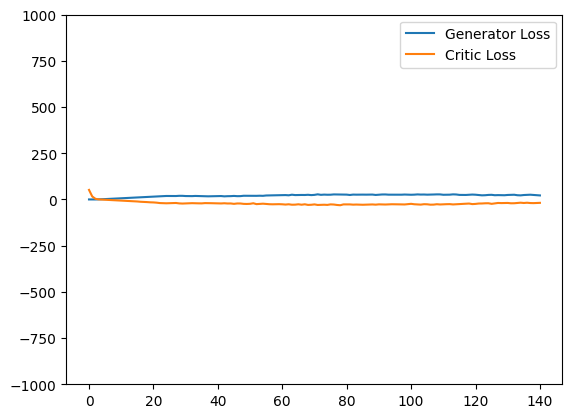

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  175 35
Saved Checkpoint


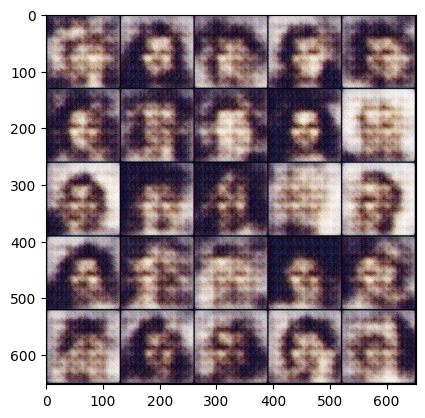

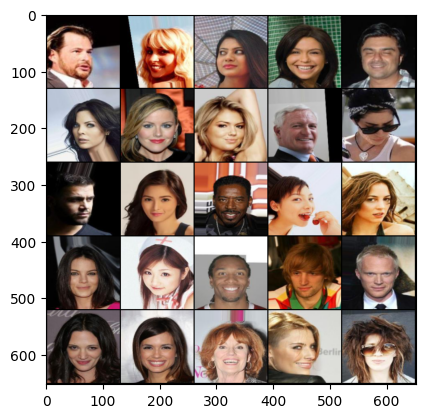

Epoch: 2 : Step 175: Generator loss: 25.60975260053362, Critic loss: -18.26407745906285


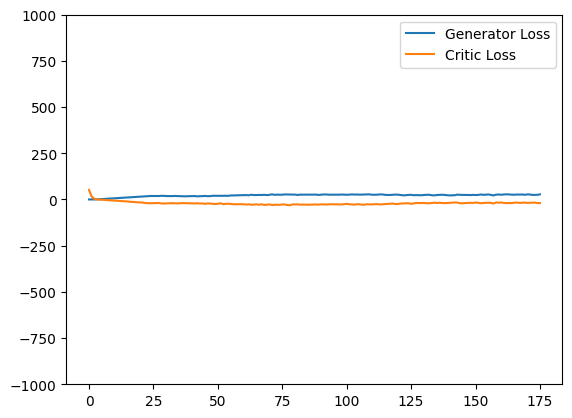

Saving checkpoint:  210 35
Saved Checkpoint


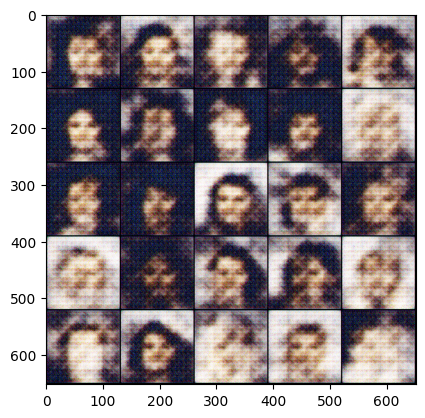

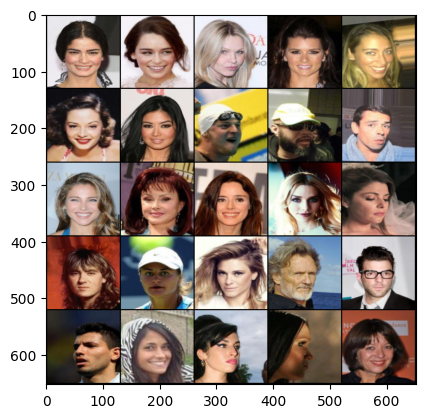

Epoch: 2 : Step 210: Generator loss: 27.420361055646623, Critic loss: -17.55908460344587


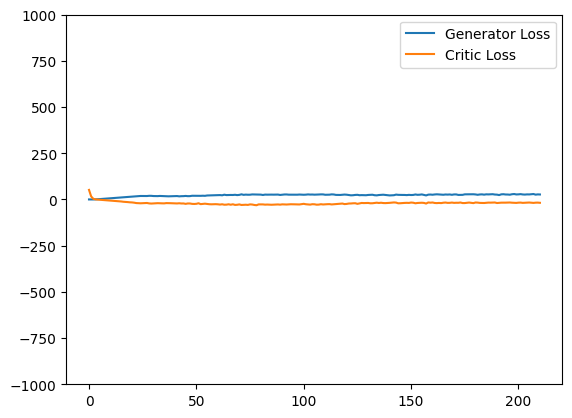

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  245 35
Saved Checkpoint


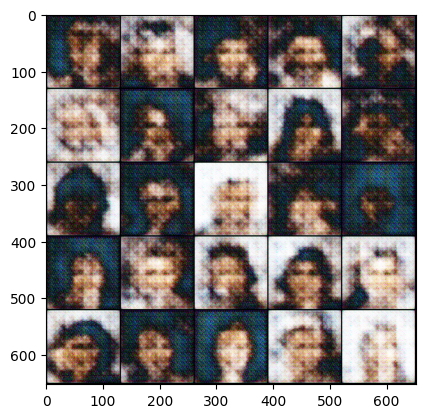

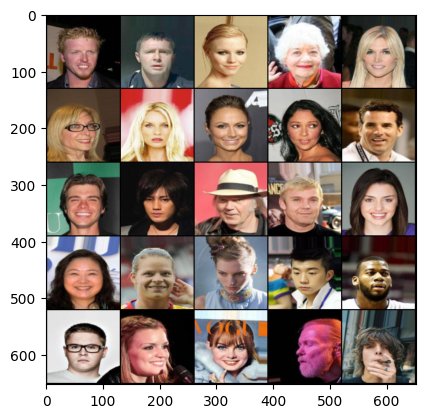

Epoch: 3 : Step 245: Generator loss: 26.298665836879184, Critic loss: -16.2961969103132


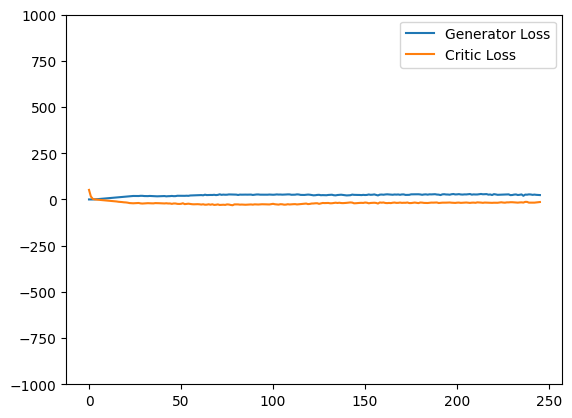

Saving checkpoint:  280 35
Saved Checkpoint


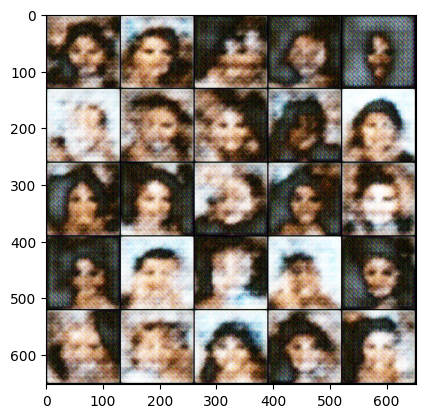

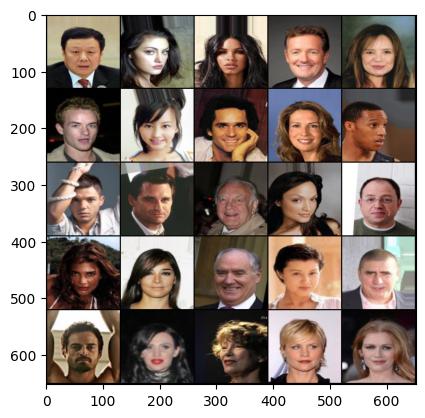

Epoch: 3 : Step 280: Generator loss: 24.98039687020438, Critic loss: -15.299527849469866


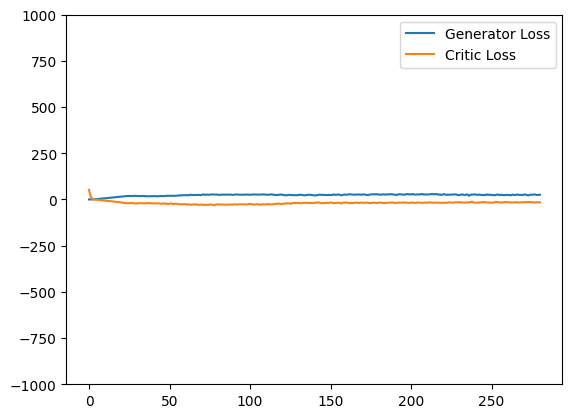

Saving checkpoint:  315 35
Saved Checkpoint


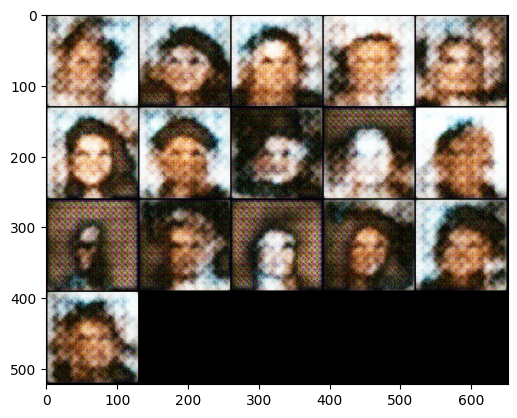

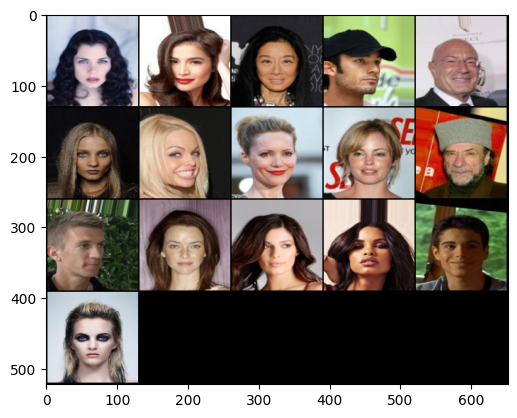

Epoch: 3 : Step 315: Generator loss: 25.940399442400253, Critic loss: -14.233205283028735


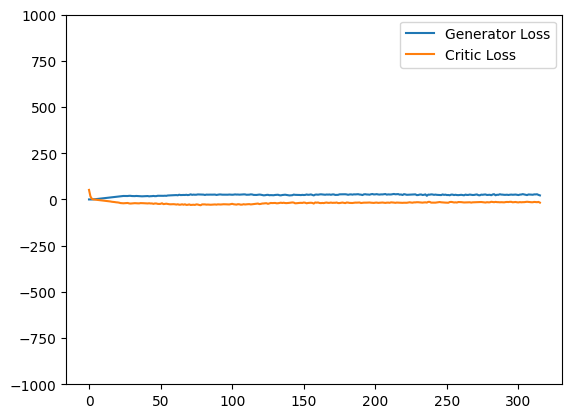

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  350 35
Saved Checkpoint


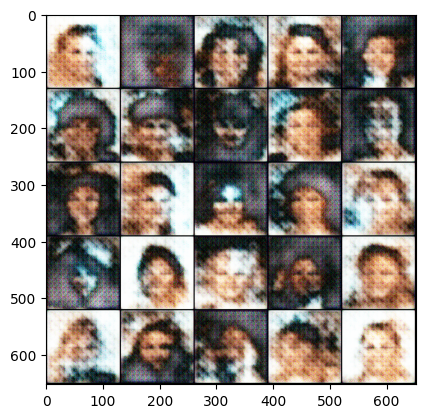

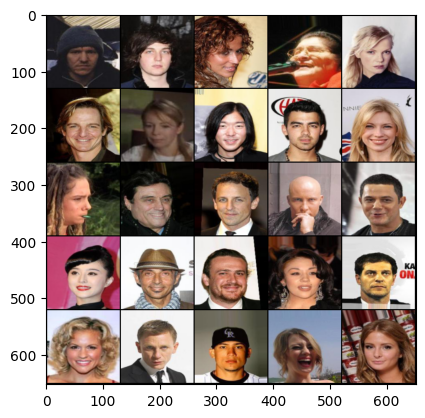

Epoch: 4 : Step 350: Generator loss: 27.08004471915109, Critic loss: -14.347180622645787


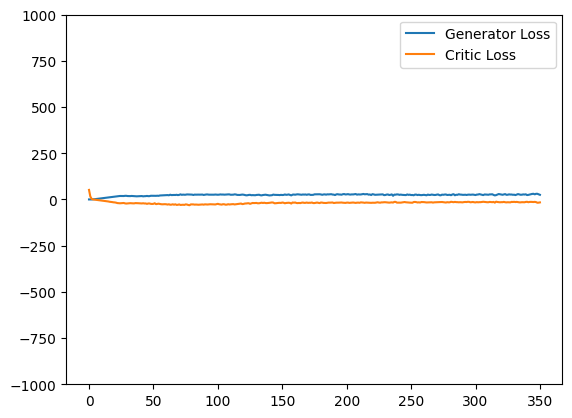

Saving checkpoint:  385 35
Saved Checkpoint


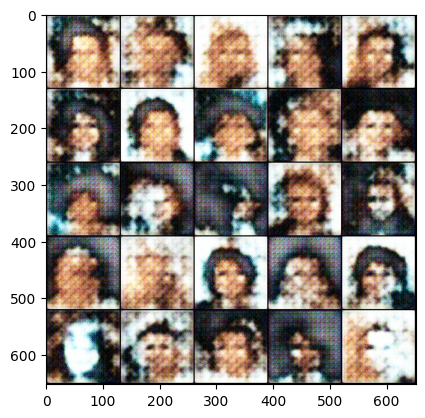

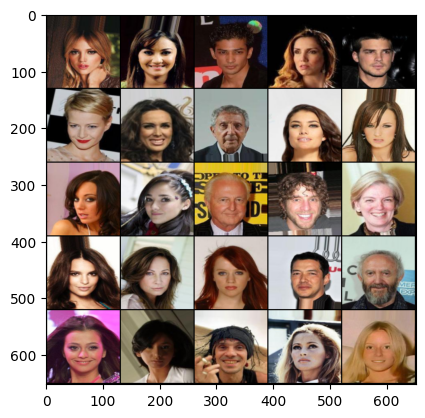

Epoch: 4 : Step 385: Generator loss: 27.779888589041573, Critic loss: -13.458145953587124


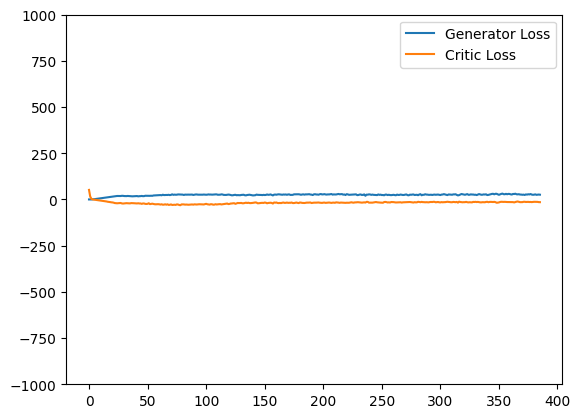

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  420 35
Saved Checkpoint


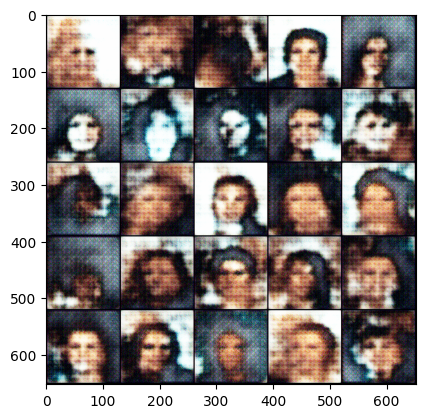

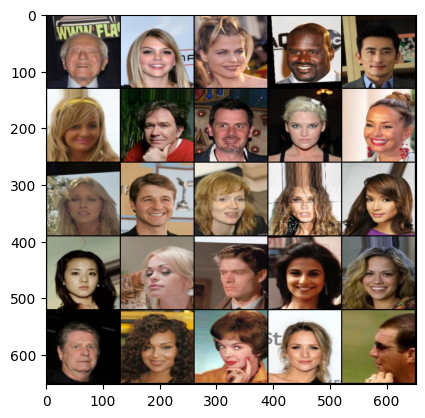

Epoch: 5 : Step 420: Generator loss: 27.619480351039343, Critic loss: -12.581815408979143


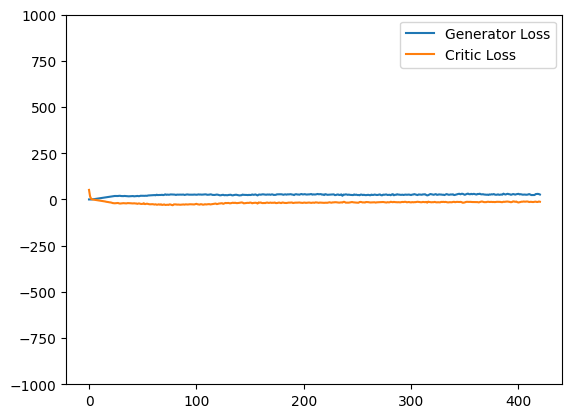

Saving checkpoint:  455 35
Saved Checkpoint


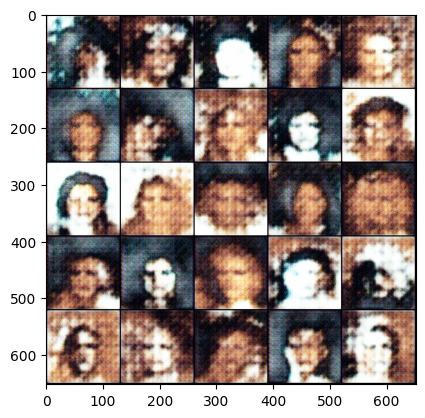

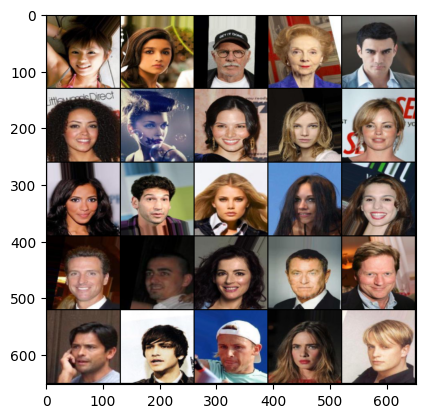

Epoch: 5 : Step 455: Generator loss: 27.265513447352816, Critic loss: -12.020788331712996


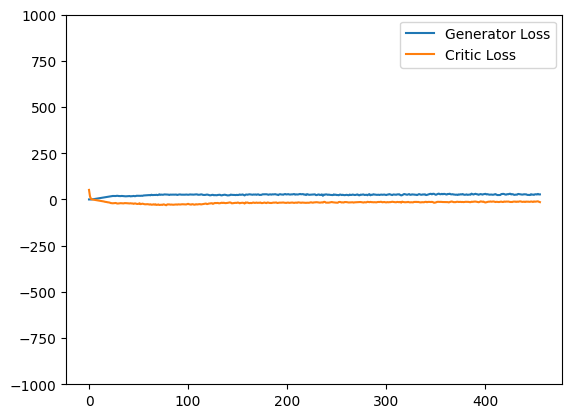

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  490 35
Saved Checkpoint


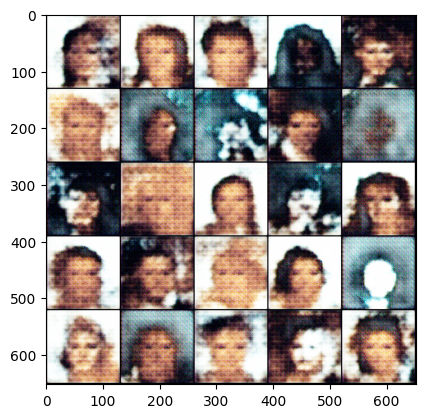

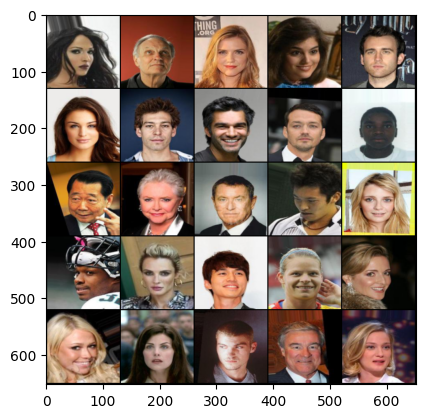

Epoch: 6 : Step 490: Generator loss: 27.643175779070173, Critic loss: -11.548739768436974


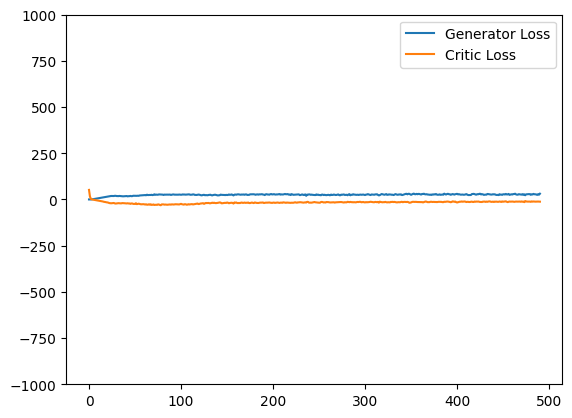

Saving checkpoint:  525 35
Saved Checkpoint


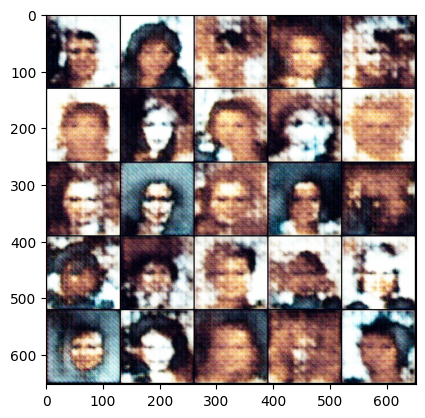

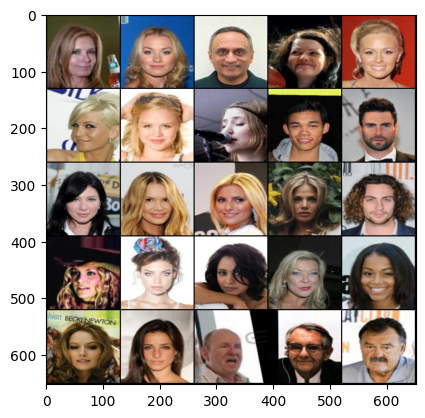

Epoch: 6 : Step 525: Generator loss: 27.22192415509905, Critic loss: -11.32718458175659


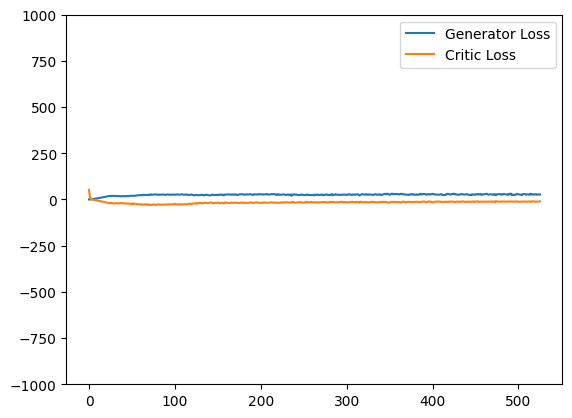

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  560 35
Saved Checkpoint


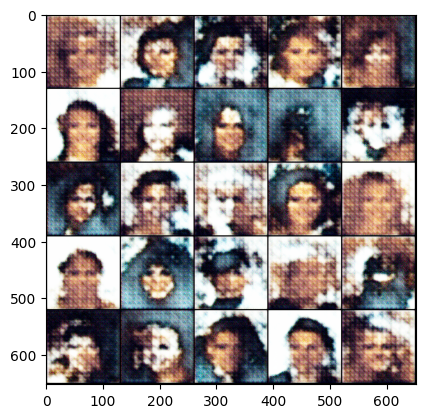

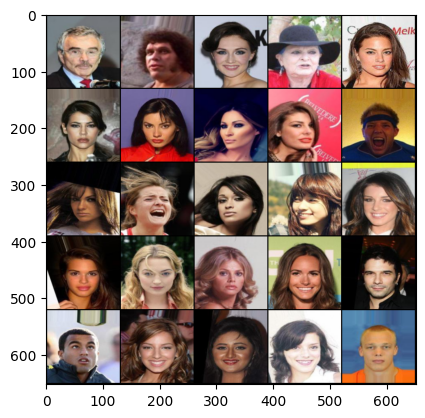

Epoch: 7 : Step 560: Generator loss: 28.236502129690987, Critic loss: -11.092333880833214


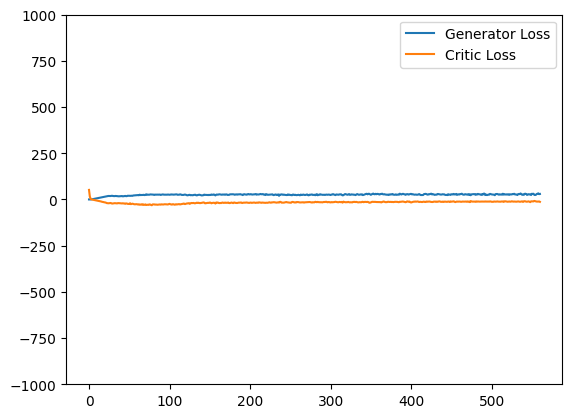

Saving checkpoint:  595 35
Saved Checkpoint


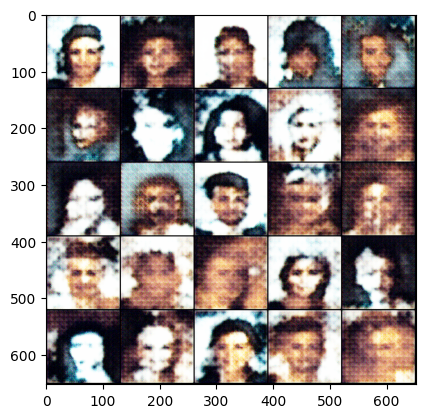

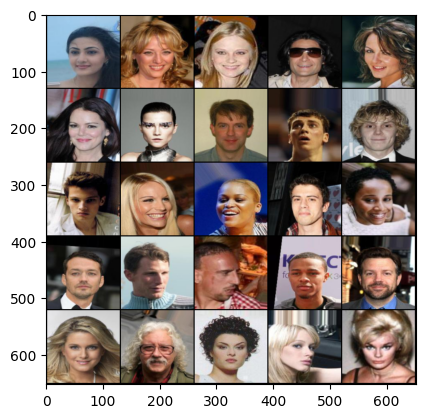

Epoch: 7 : Step 595: Generator loss: 29.318741171700612, Critic loss: -10.943879604339601


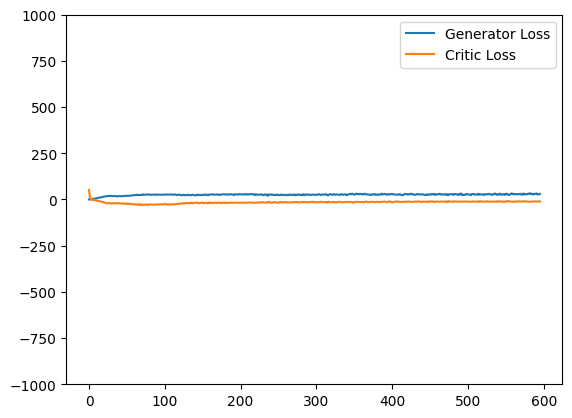

Saving checkpoint:  630 35
Saved Checkpoint


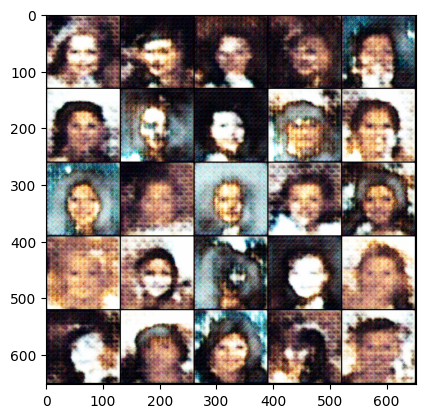

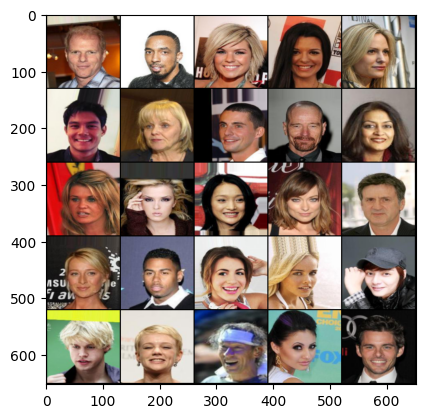

Epoch: 7 : Step 630: Generator loss: 29.827330507550922, Critic loss: -10.630784784044538


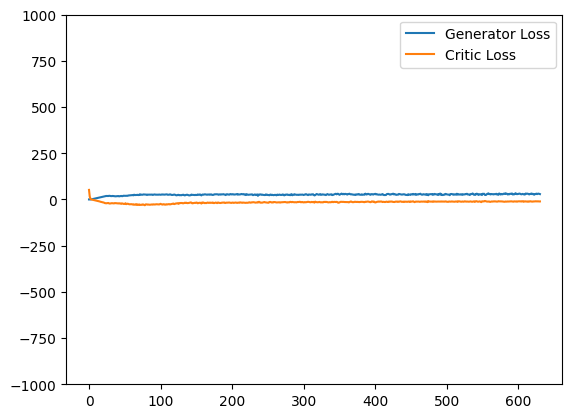

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  665 35
Saved Checkpoint


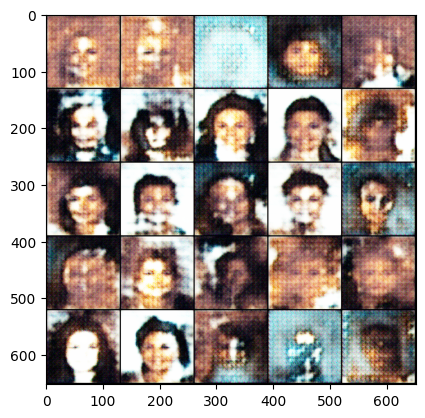

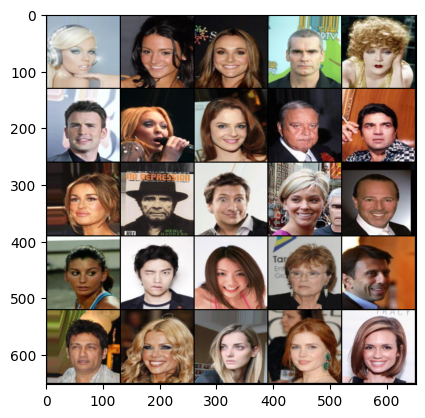

Epoch: 8 : Step 665: Generator loss: 29.61522091456822, Critic loss: -10.34399907520839


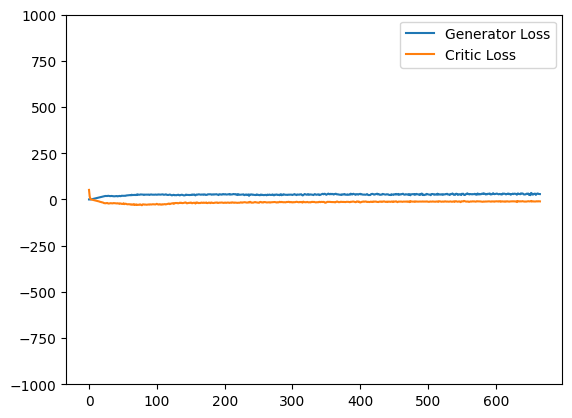

Saving checkpoint:  700 35
Saved Checkpoint


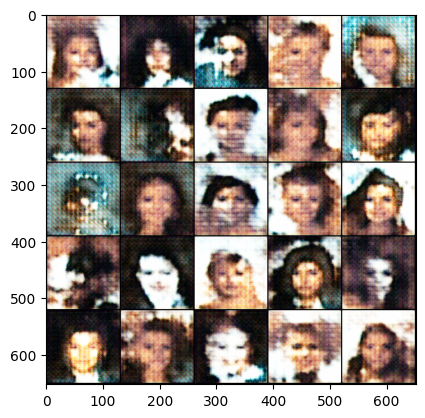

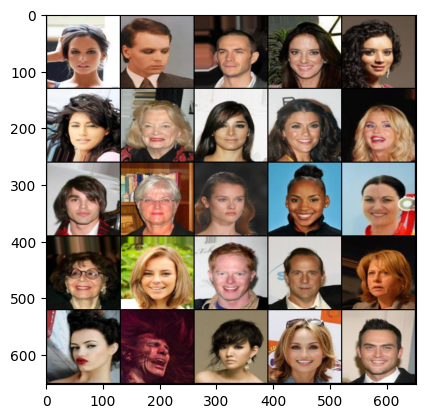

Epoch: 8 : Step 700: Generator loss: 30.243620845249723, Critic loss: -10.043436663491384


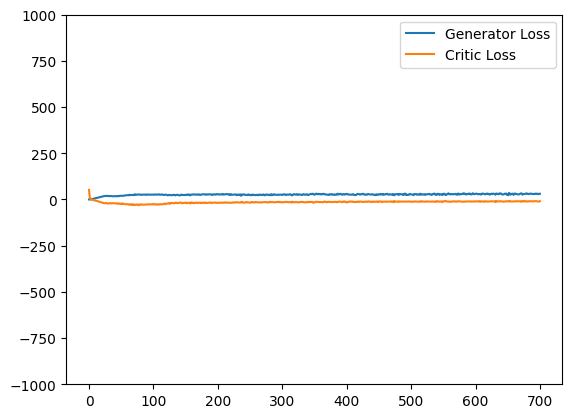

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  735 35
Saved Checkpoint


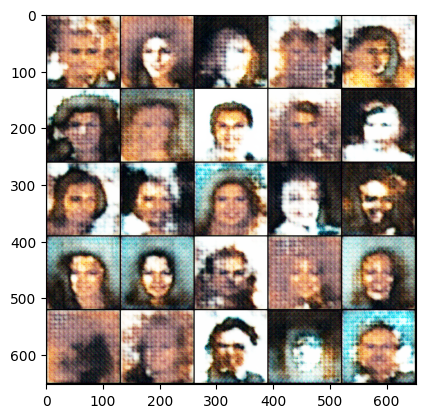

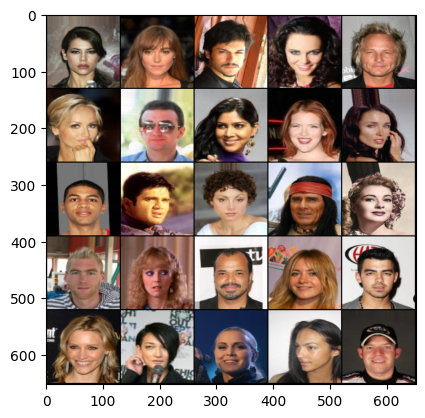

Epoch: 9 : Step 735: Generator loss: 31.11422358921596, Critic loss: -10.18143917356219


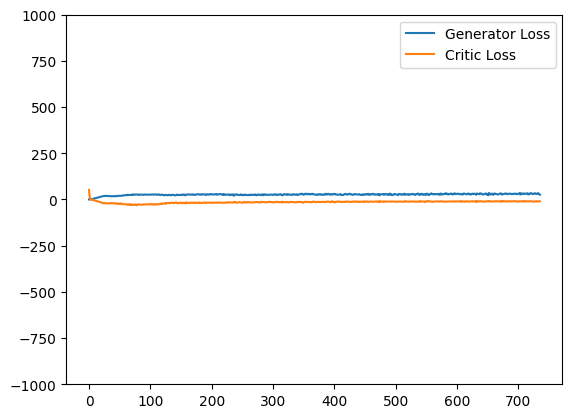

Saving checkpoint:  770 35
Saved Checkpoint


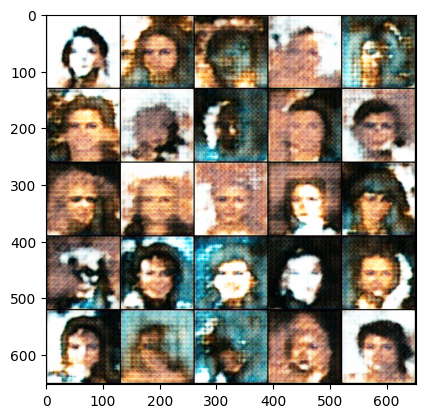

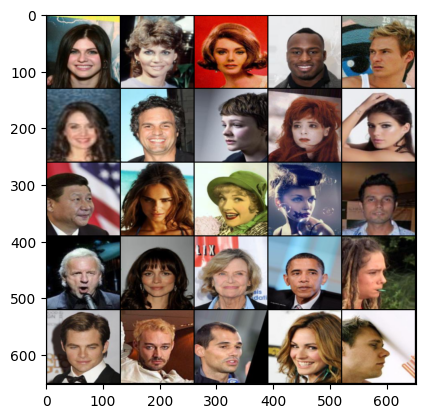

Epoch: 9 : Step 770: Generator loss: 30.842318725585937, Critic loss: -9.624839632851739


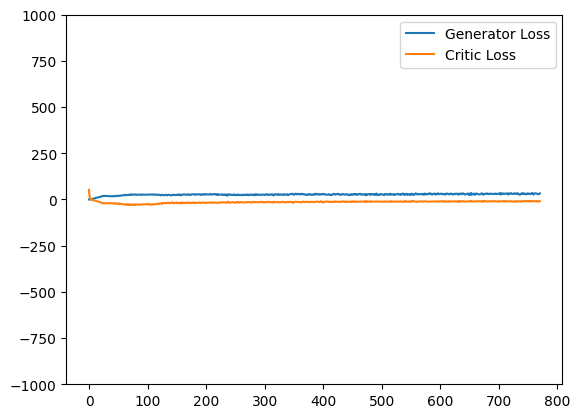

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  805 35
Saved Checkpoint


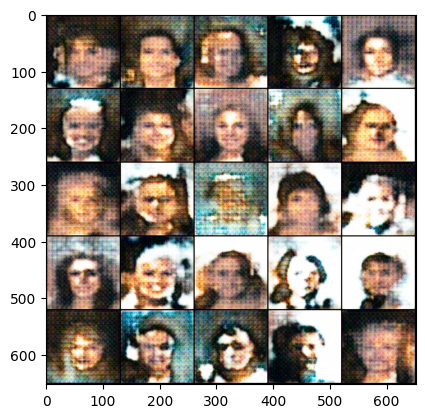

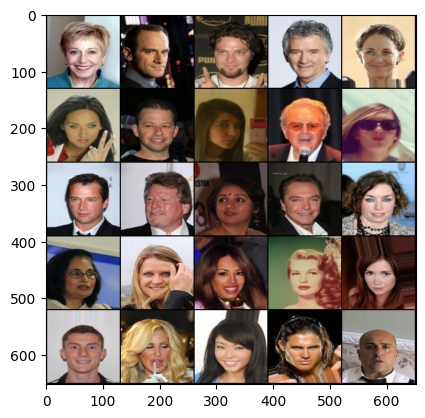

Epoch: 10 : Step 805: Generator loss: 31.264710889543807, Critic loss: -9.530565774100168


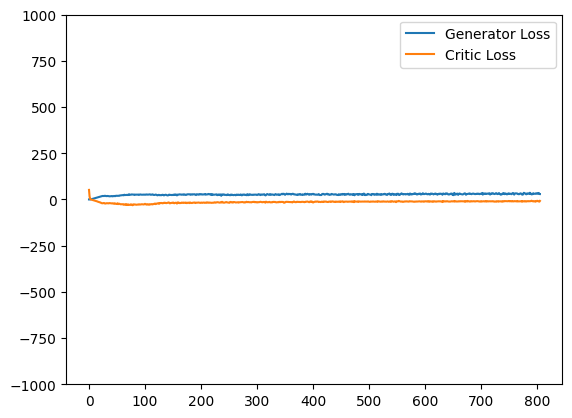

Saving checkpoint:  840 35
Saved Checkpoint


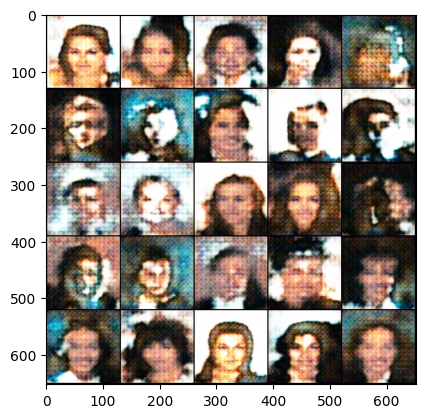

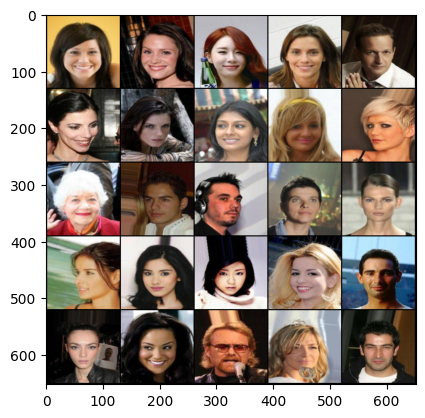

Epoch: 10 : Step 840: Generator loss: 32.100954110281805, Critic loss: -9.363968669346397


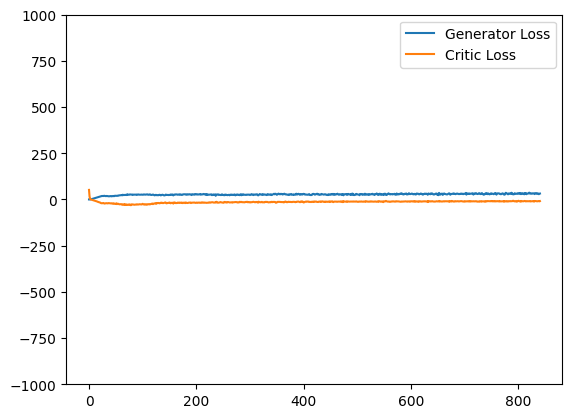

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  875 35
Saved Checkpoint


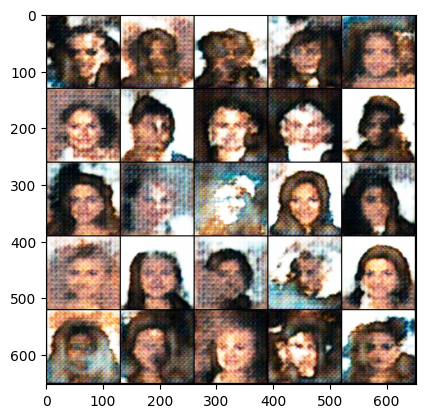

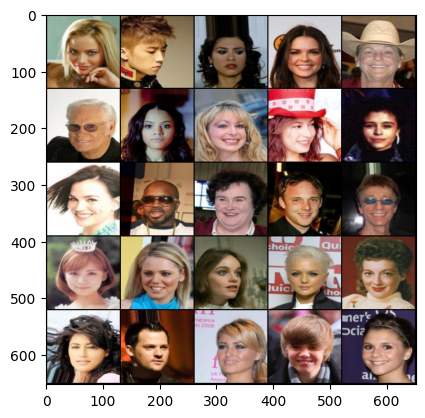

Epoch: 11 : Step 875: Generator loss: 32.575678089686804, Critic loss: -9.368797582898821


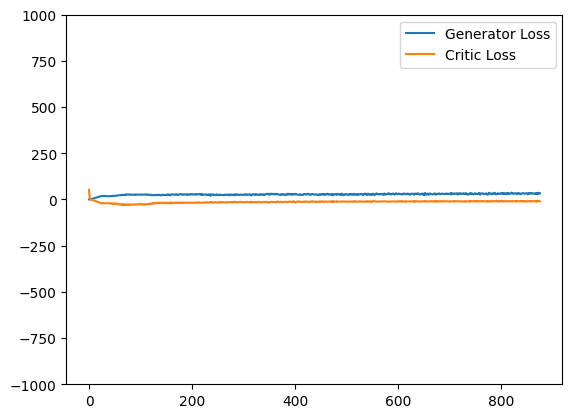

Saving checkpoint:  910 35
Saved Checkpoint


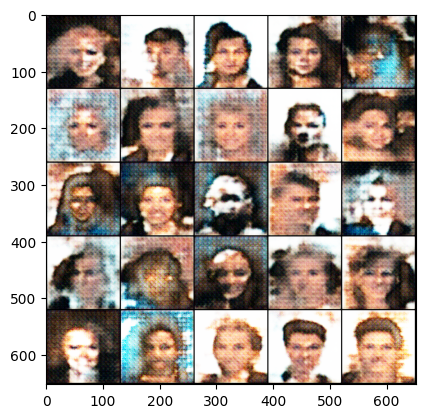

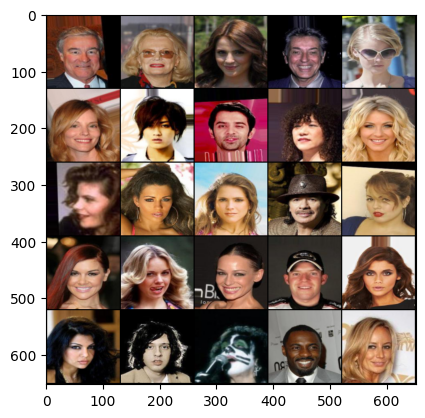

Epoch: 11 : Step 910: Generator loss: 32.92167865208217, Critic loss: -9.254908599853517


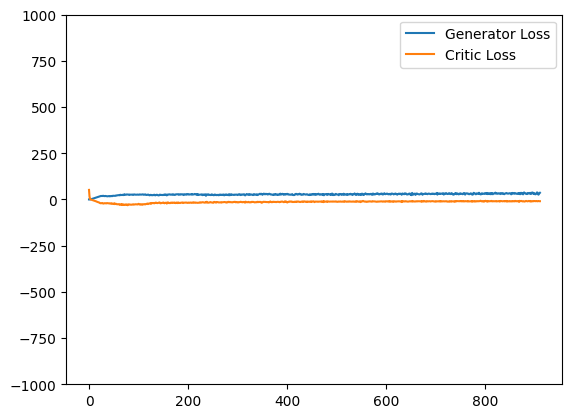

Saving checkpoint:  945 35
Saved Checkpoint


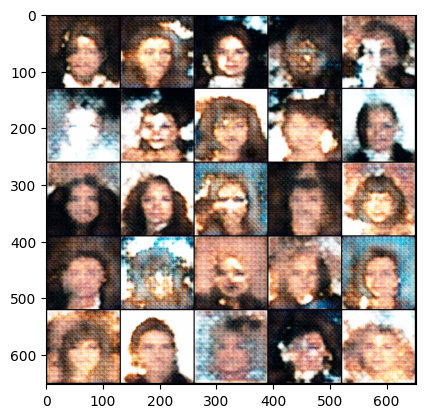

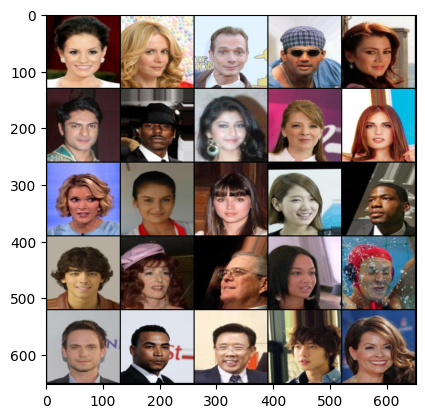

Epoch: 11 : Step 945: Generator loss: 33.46327394757952, Critic loss: -9.209977433340892


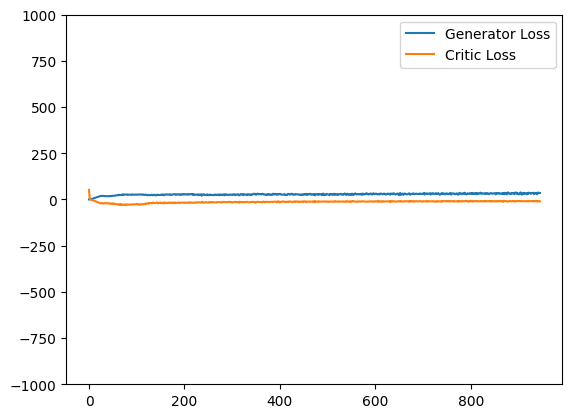

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  980 35
Saved Checkpoint


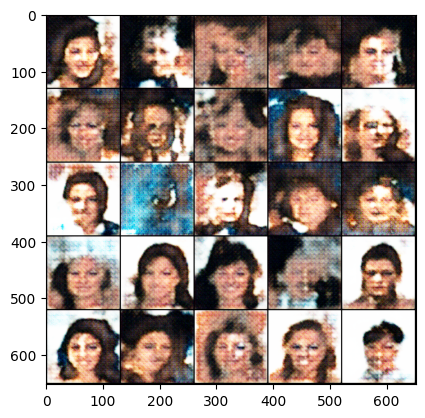

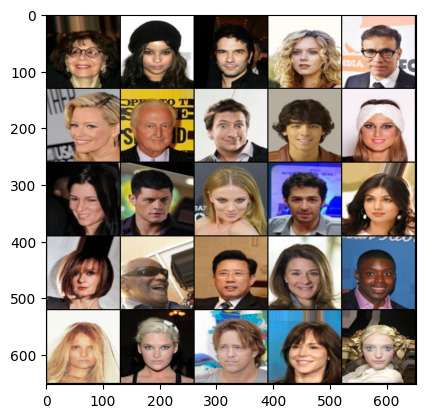

Epoch: 12 : Step 980: Generator loss: 32.69913706098284, Critic loss: -9.011074085235595


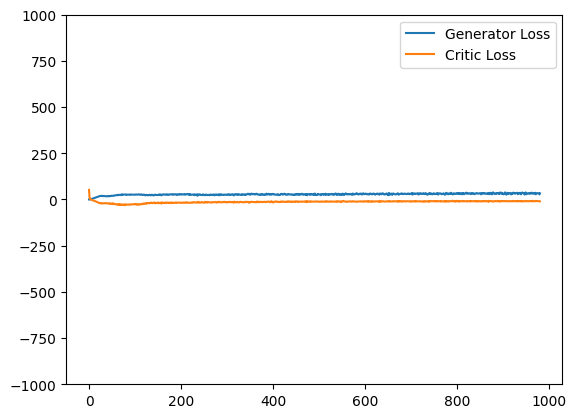

Saving checkpoint:  1015 35
Saved Checkpoint


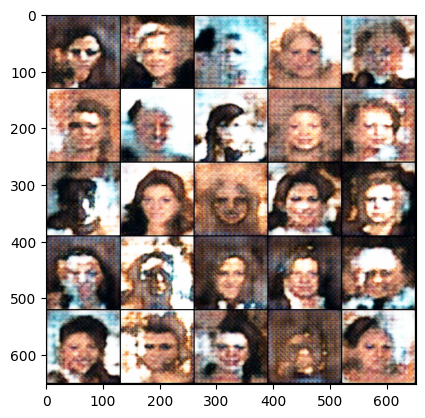

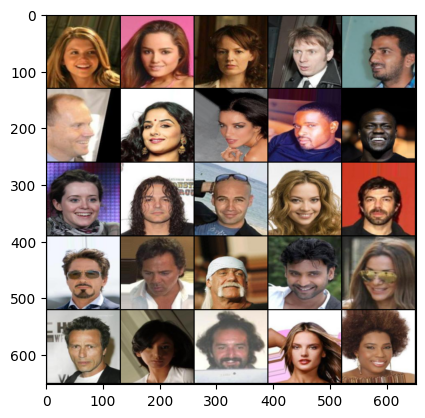

Epoch: 12 : Step 1015: Generator loss: 34.304370934622625, Critic loss: -8.749070276532857


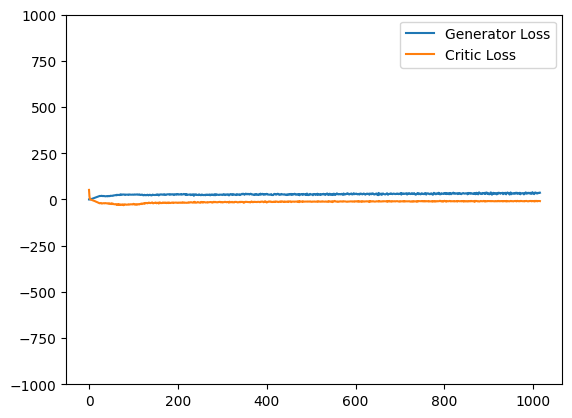

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1050 35
Saved Checkpoint


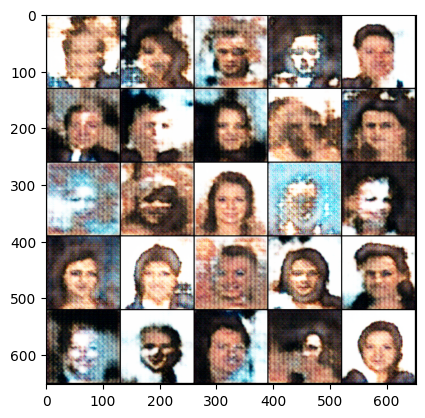

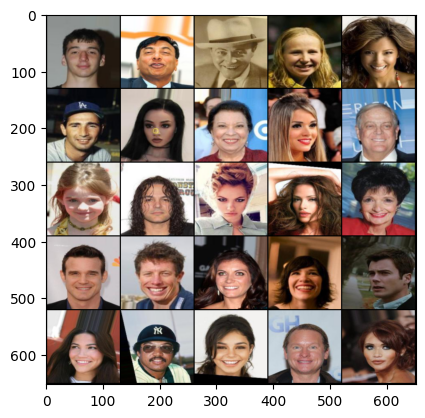

Epoch: 13 : Step 1050: Generator loss: 33.10780792236328, Critic loss: -8.773153191975185


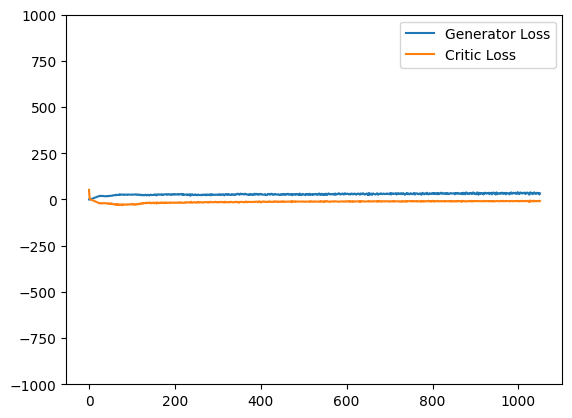

Saving checkpoint:  1085 35
Saved Checkpoint


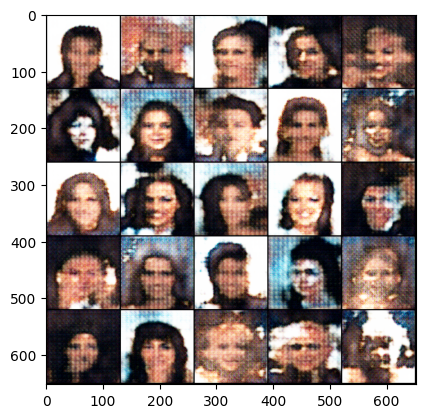

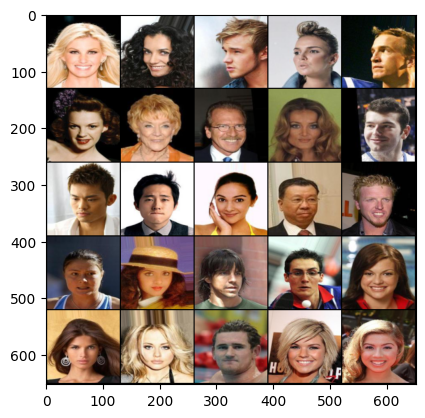

Epoch: 13 : Step 1085: Generator loss: 33.82363319396973, Critic loss: -8.584432634626117


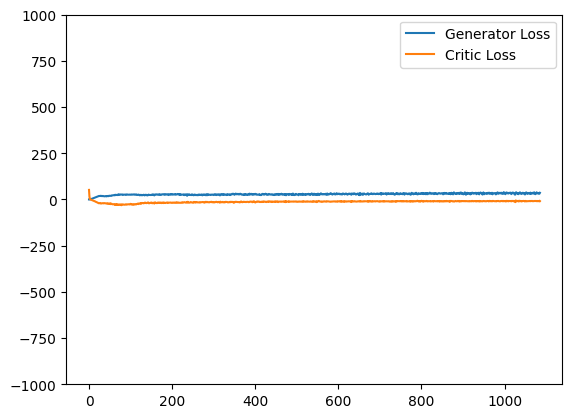

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1120 35
Saved Checkpoint


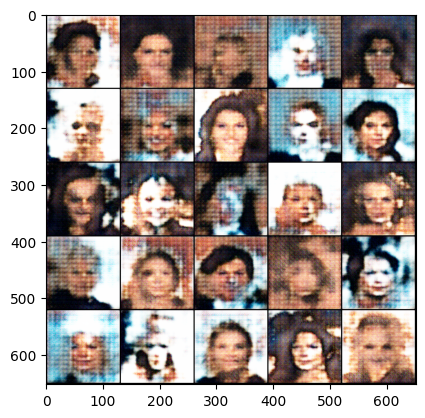

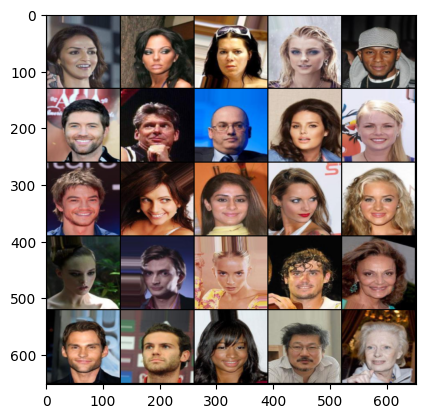

Epoch: 14 : Step 1120: Generator loss: 33.82288693019322, Critic loss: -8.724785457338605


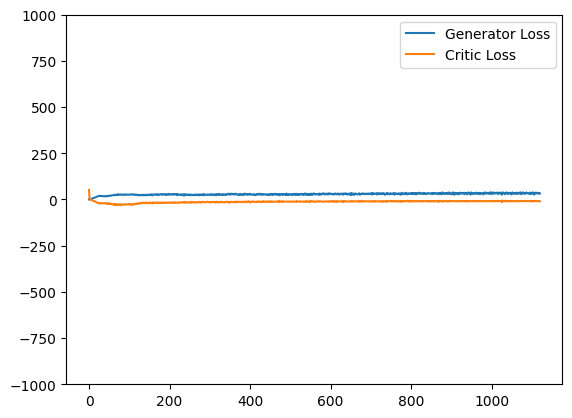

Saving checkpoint:  1155 35
Saved Checkpoint


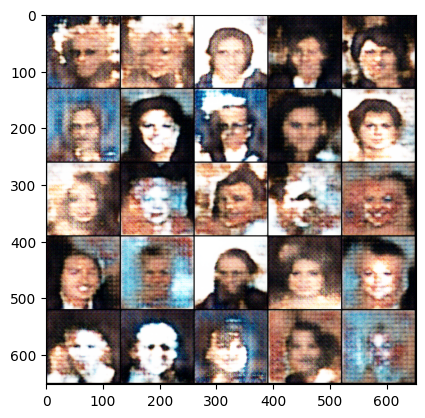

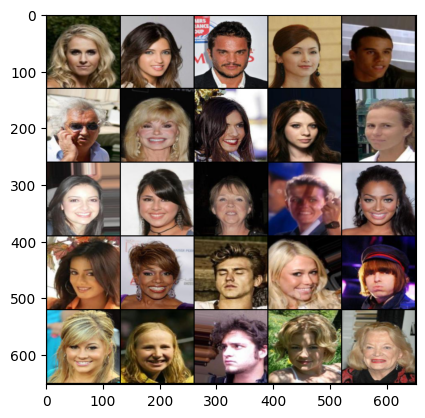

Epoch: 14 : Step 1155: Generator loss: 33.74573473249163, Critic loss: -8.683573477608814


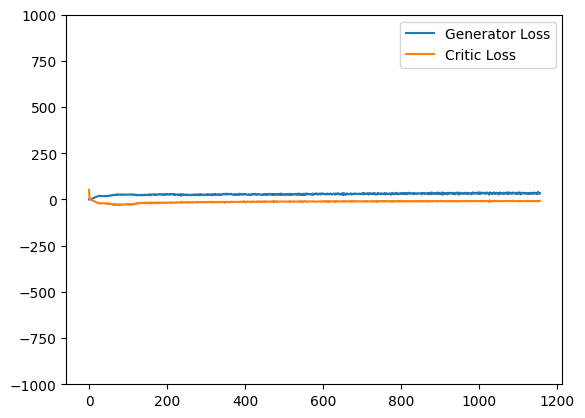

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1190 35
Saved Checkpoint


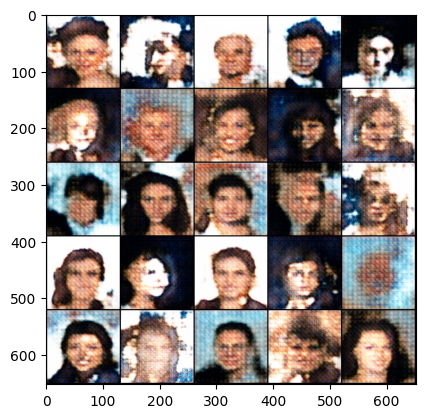

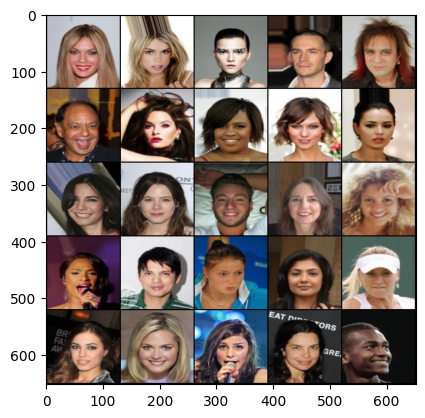

Epoch: 15 : Step 1190: Generator loss: 33.7988270350865, Critic loss: -8.4498569216047


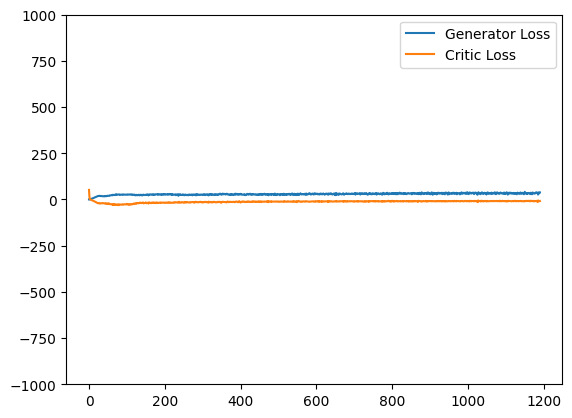

Saving checkpoint:  1225 35
Saved Checkpoint


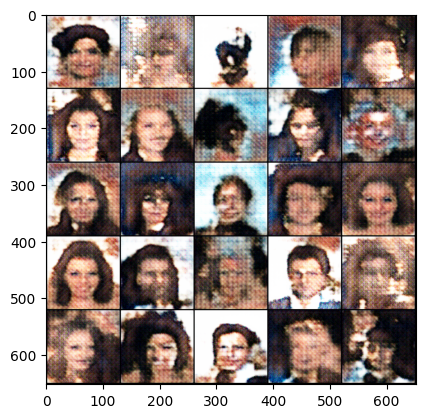

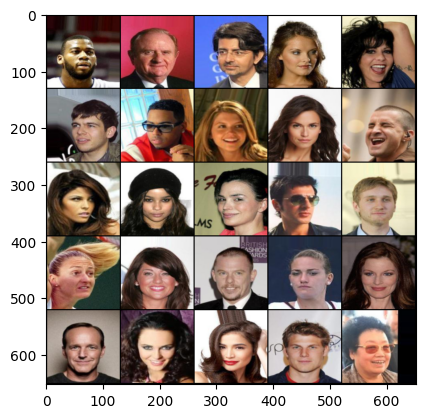

Epoch: 15 : Step 1225: Generator loss: 33.61717169625418, Critic loss: -8.430537548065185


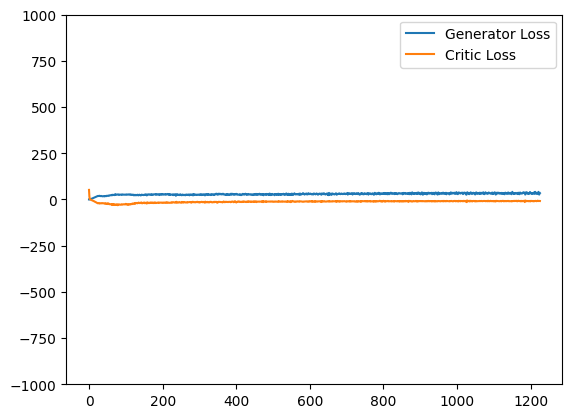

Saving checkpoint:  1260 35
Saved Checkpoint


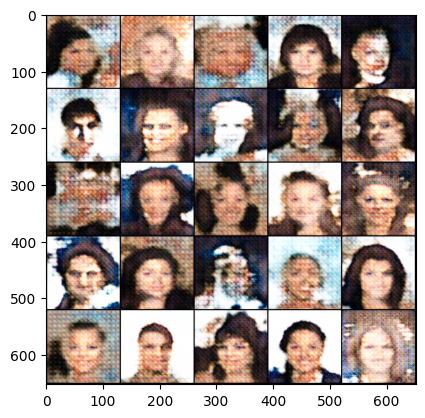

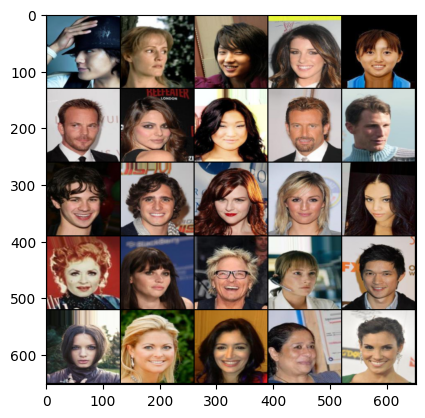

Epoch: 15 : Step 1260: Generator loss: 34.24164412362235, Critic loss: -8.288762817382812


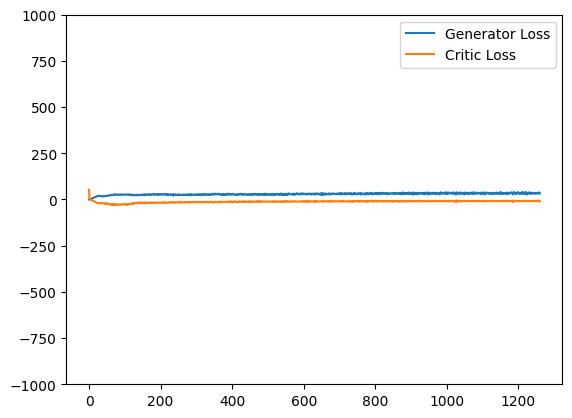

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1295 35
Saved Checkpoint


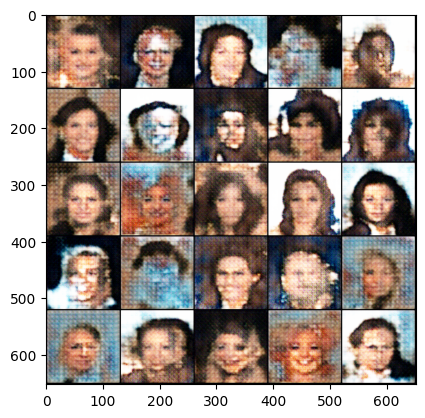

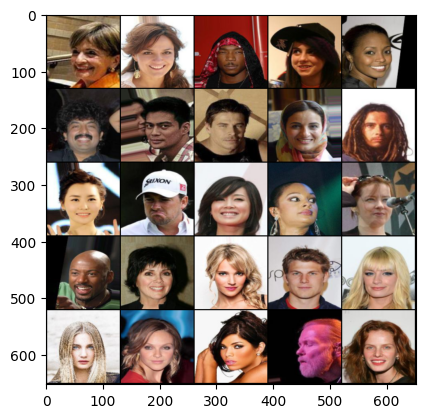

Epoch: 16 : Step 1295: Generator loss: 34.5662648337228, Critic loss: -8.54482463291713


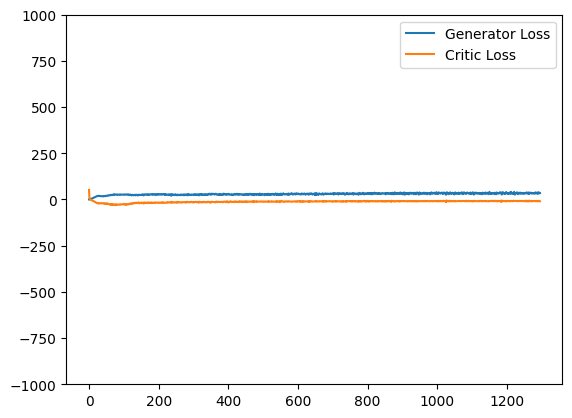

Saving checkpoint:  1330 35
Saved Checkpoint


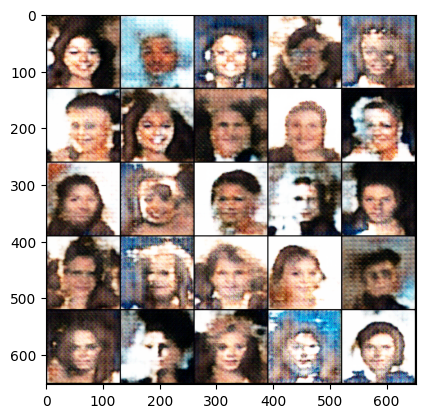

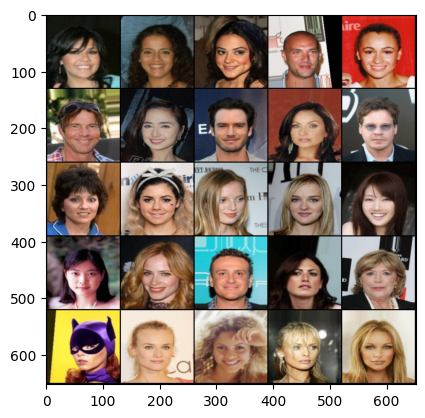

Epoch: 16 : Step 1330: Generator loss: 33.615538242885044, Critic loss: -8.082513525826592


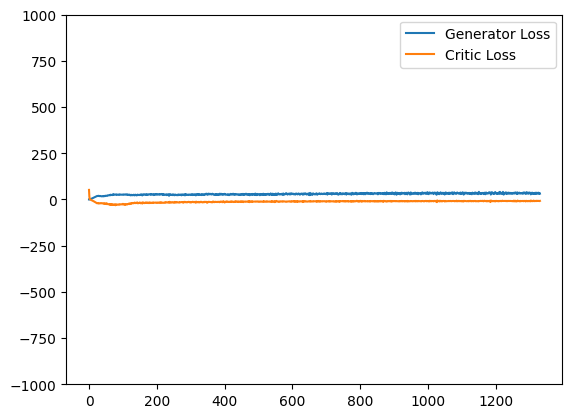

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1365 35
Saved Checkpoint


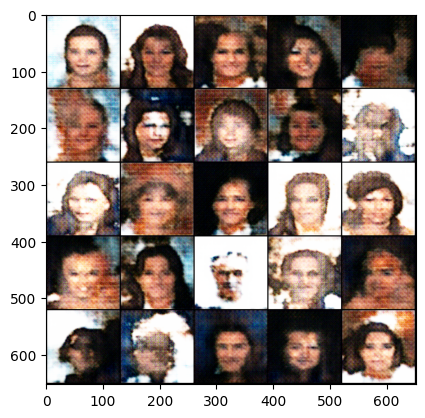

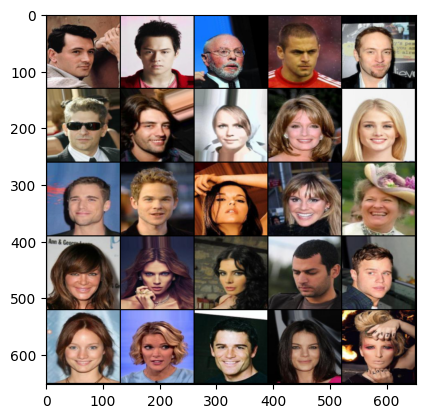

Epoch: 17 : Step 1365: Generator loss: 34.31018240792411, Critic loss: -8.223876109804424


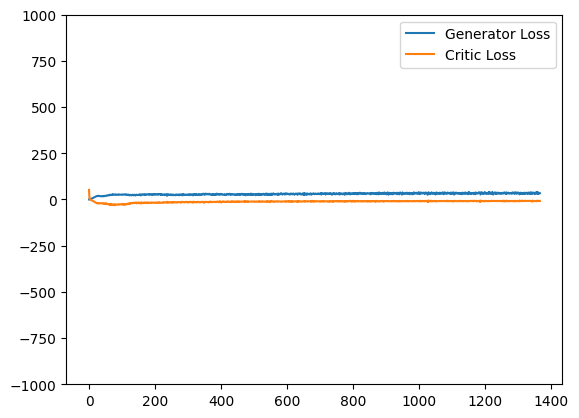

Saving checkpoint:  1400 35
Saved Checkpoint


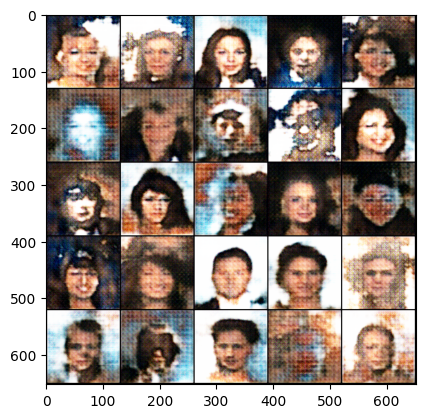

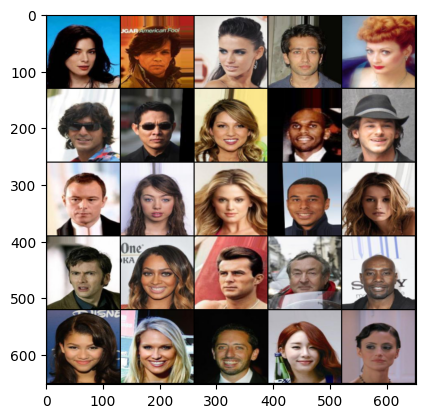

Epoch: 17 : Step 1400: Generator loss: 33.55225475856236, Critic loss: -8.27020107133048


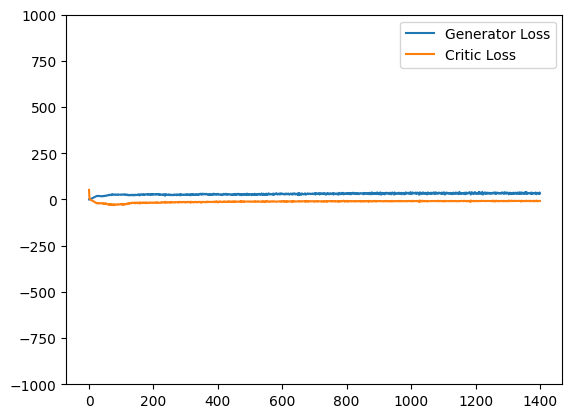

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1435 35
Saved Checkpoint


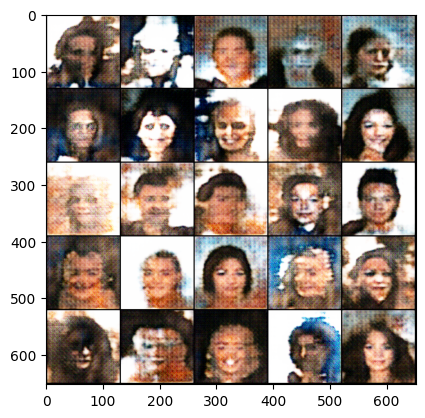

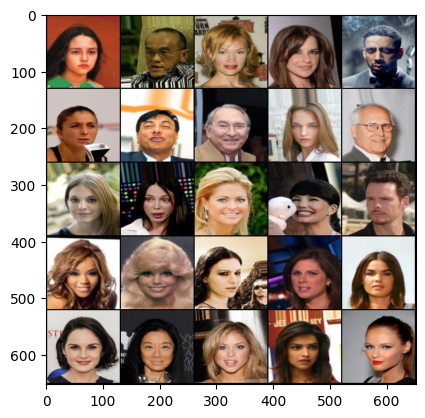

Epoch: 18 : Step 1435: Generator loss: 34.20546177455357, Critic loss: -8.110973341805593


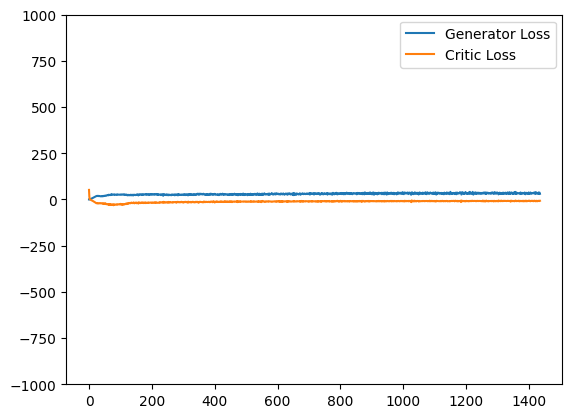

Saving checkpoint:  1470 35
Saved Checkpoint


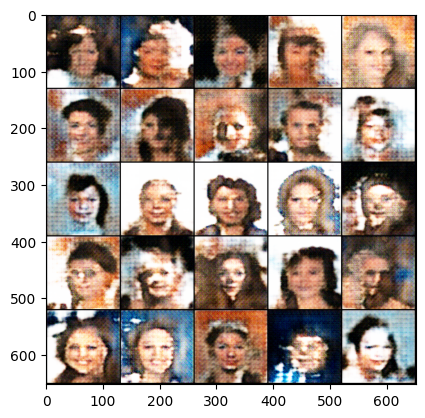

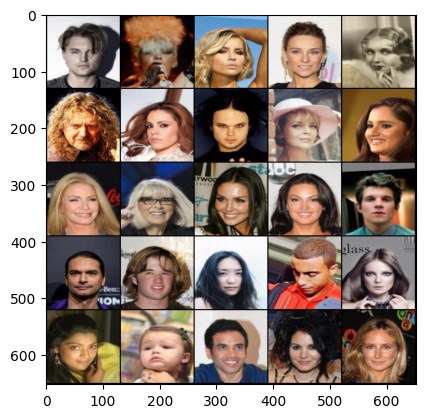

Epoch: 18 : Step 1470: Generator loss: 33.60045351300921, Critic loss: -8.161371754237582


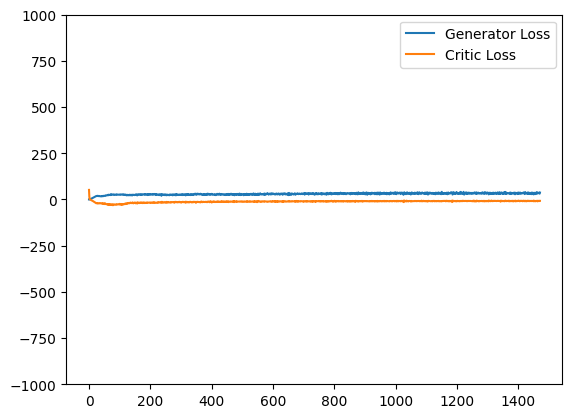

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1505 35
Saved Checkpoint


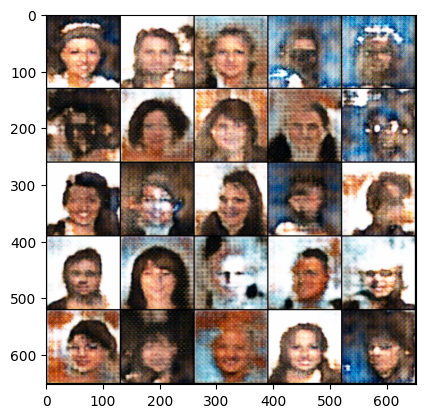

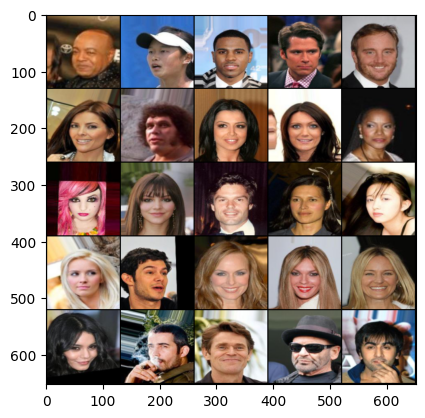

Epoch: 19 : Step 1505: Generator loss: 33.93214220319476, Critic loss: -7.779735784530638


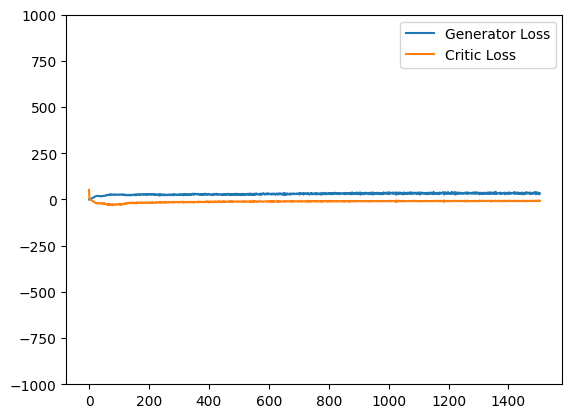

Saving checkpoint:  1540 35
Saved Checkpoint


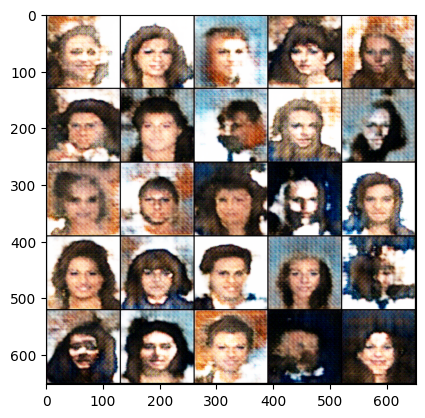

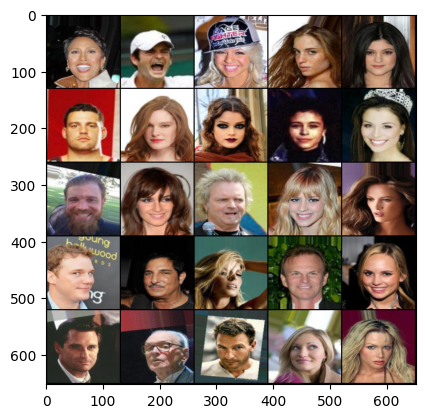

Epoch: 19 : Step 1540: Generator loss: 33.671603775024415, Critic loss: -8.116149839673723


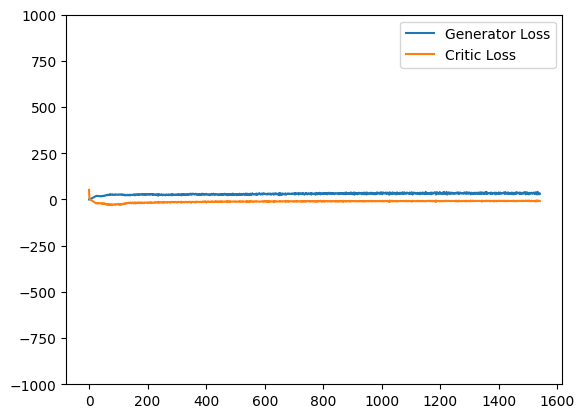

Saving checkpoint:  1575 35
Saved Checkpoint


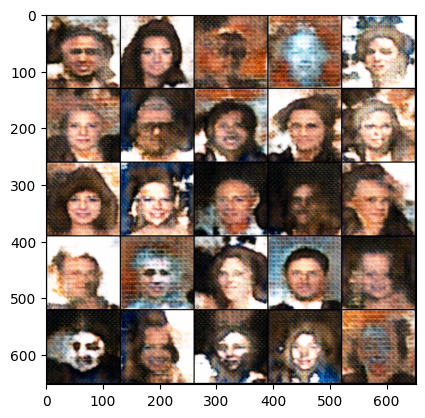

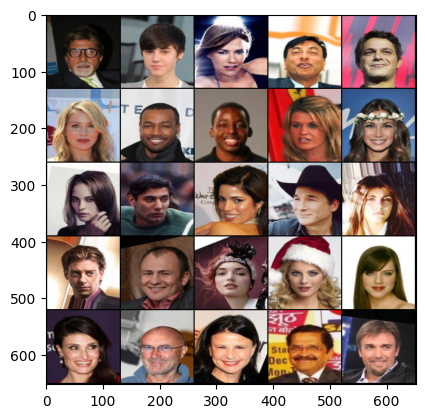

Epoch: 19 : Step 1575: Generator loss: 33.1015686580113, Critic loss: -8.014890030452184


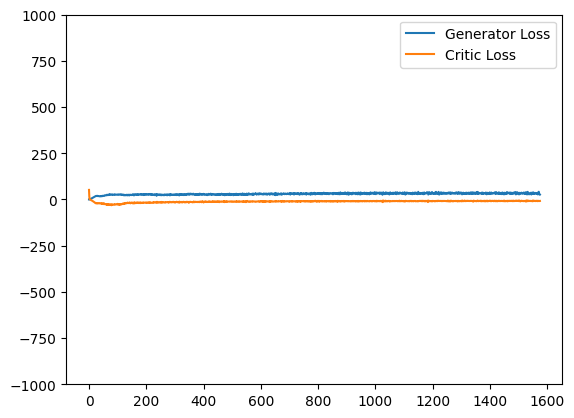

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1610 35
Saved Checkpoint


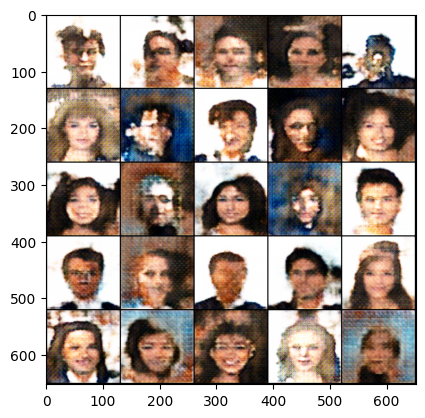

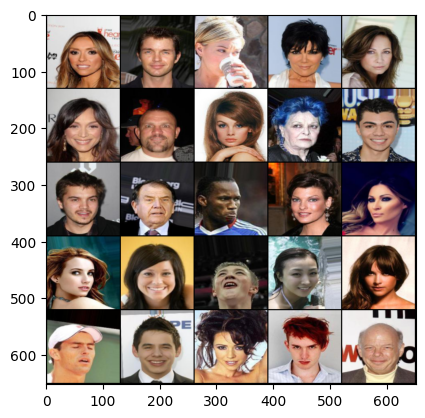

Epoch: 20 : Step 1610: Generator loss: 33.25712520054409, Critic loss: -7.9016140501839764


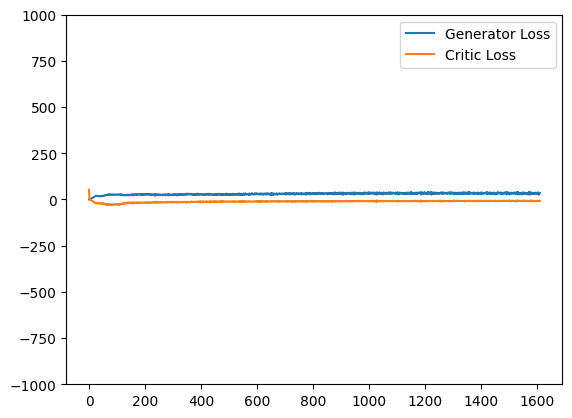

Saving checkpoint:  1645 35
Saved Checkpoint


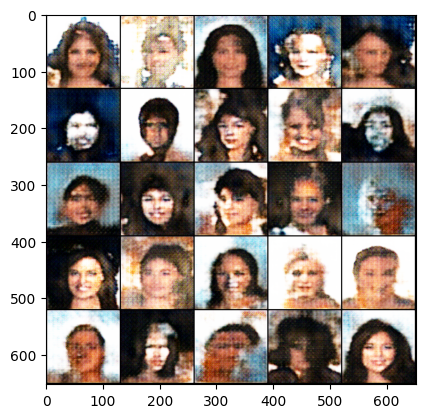

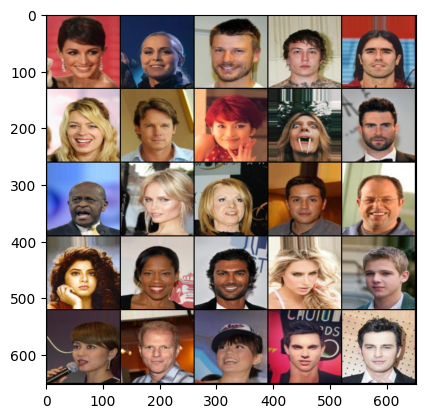

Epoch: 20 : Step 1645: Generator loss: 32.68010161263602, Critic loss: -8.006392824990408


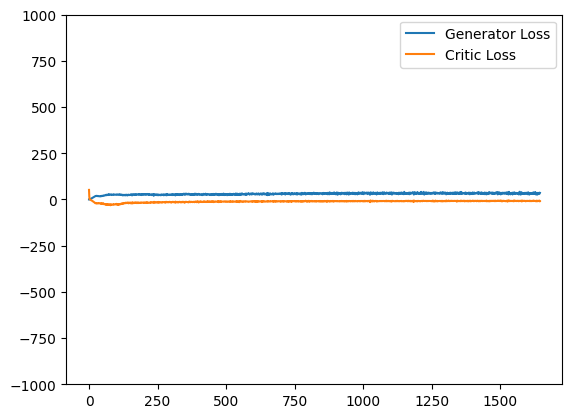

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1680 35
Saved Checkpoint


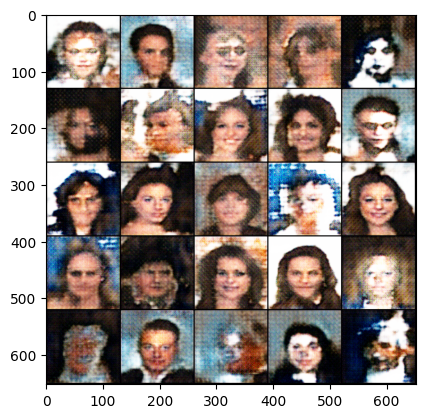

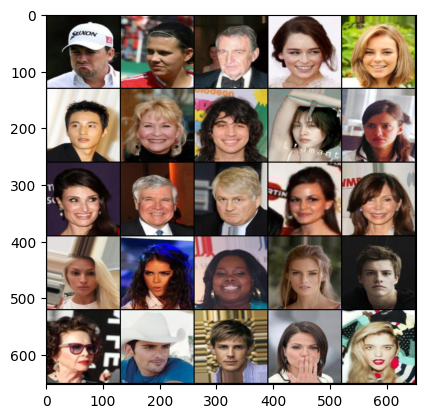

Epoch: 21 : Step 1680: Generator loss: 32.942720086233955, Critic loss: -7.854500188827514


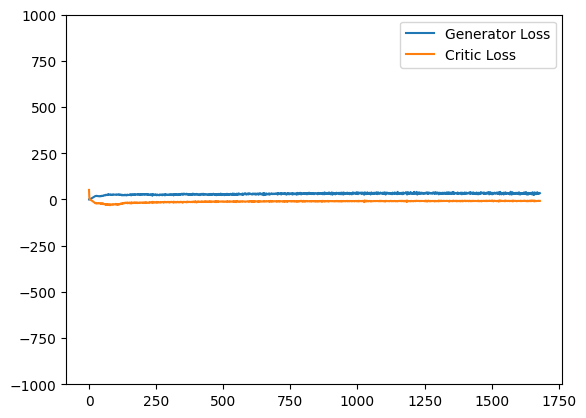

Saving checkpoint:  1715 35
Saved Checkpoint


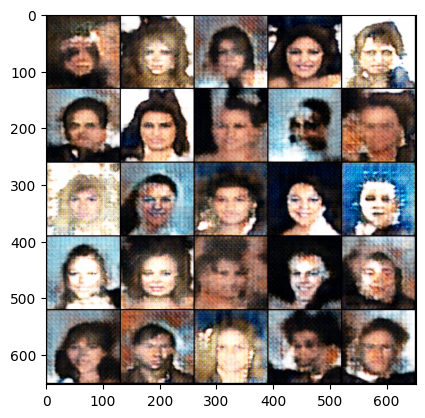

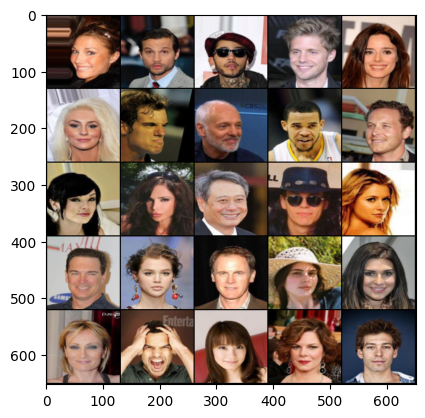

Epoch: 21 : Step 1715: Generator loss: 33.30220244271415, Critic loss: -7.844747676849366


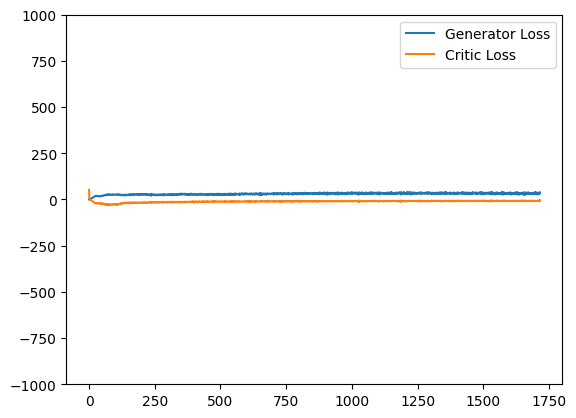

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1750 35
Saved Checkpoint


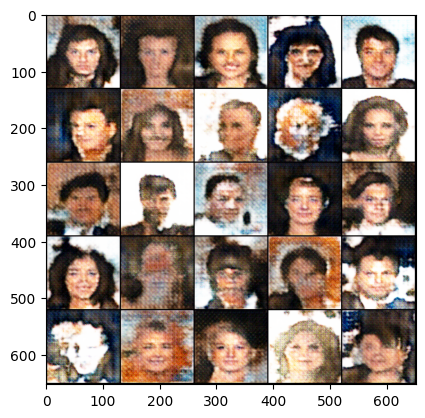

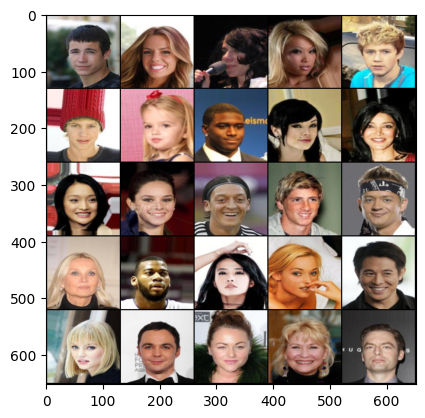

Epoch: 22 : Step 1750: Generator loss: 32.27549918038505, Critic loss: -7.786860782078335


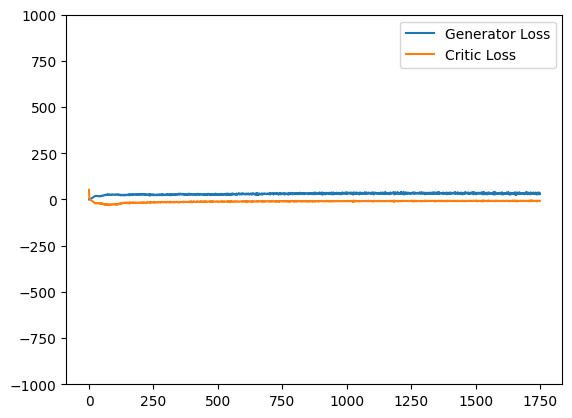

Saving checkpoint:  1785 35
Saved Checkpoint


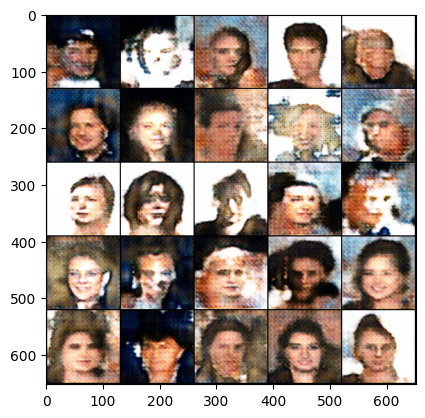

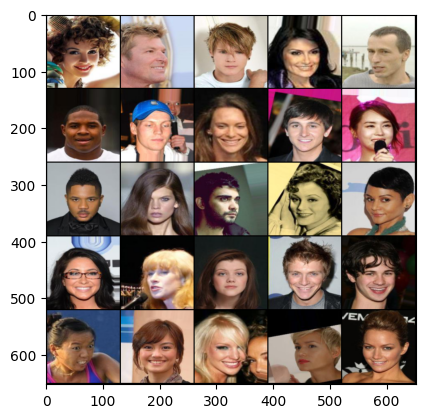

Epoch: 22 : Step 1785: Generator loss: 32.646544156755716, Critic loss: -7.885289865221296


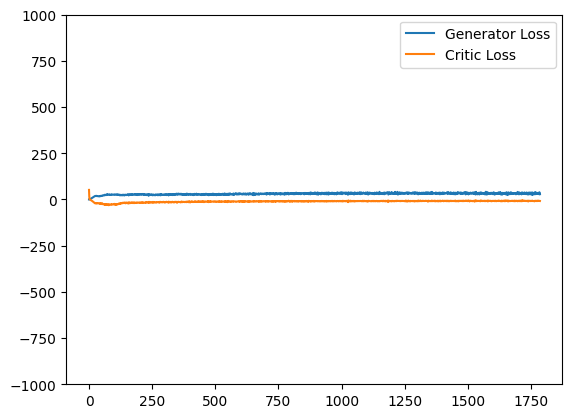

  0%|          | 0/79 [00:00<?, ?it/s]

Saving checkpoint:  1820 35
Saved Checkpoint


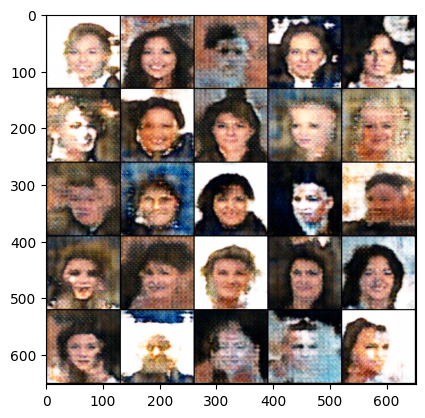

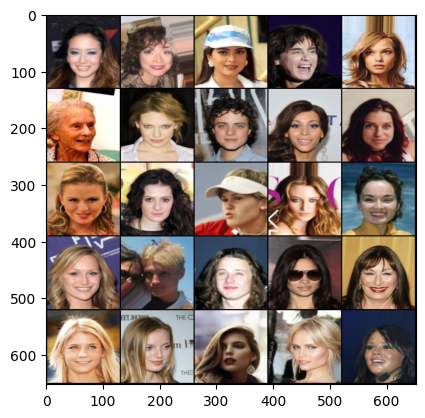

Epoch: 23 : Step 1820: Generator loss: 31.368867492675783, Critic loss: -7.576189199175154


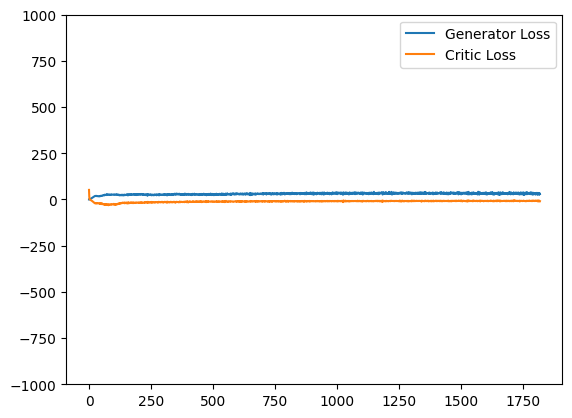

Saving checkpoint:  1855 35
Saved Checkpoint


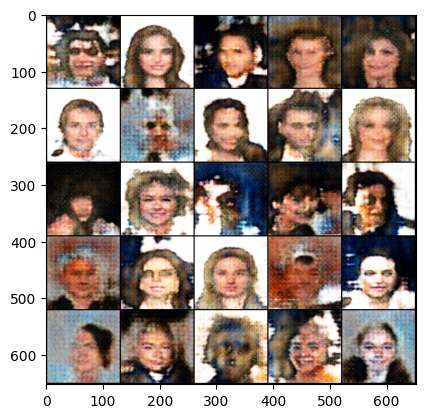

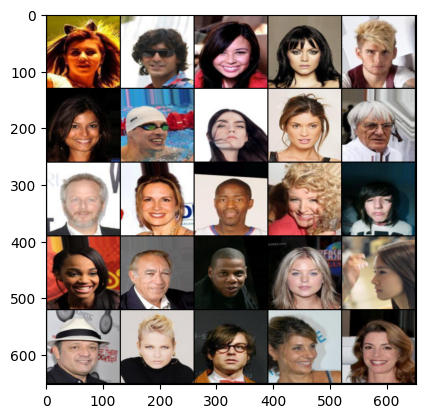

Epoch: 23 : Step 1855: Generator loss: 32.325544248308454, Critic loss: -7.798993552071707


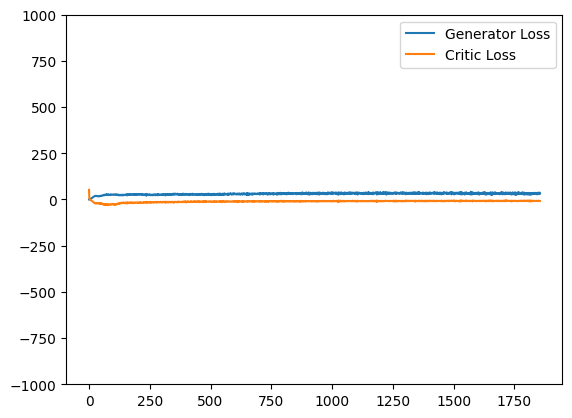

Saving checkpoint:  1890 35
Saved Checkpoint


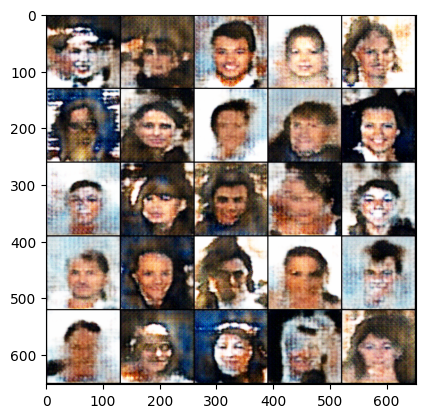

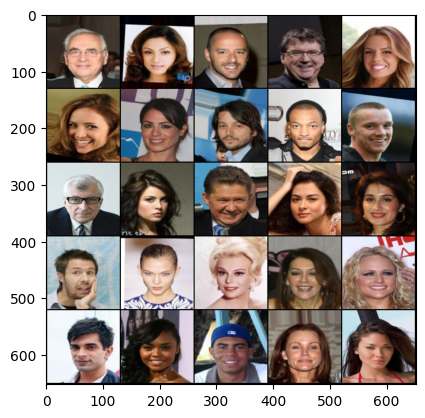

Epoch: 23 : Step 1890: Generator loss: 31.557246943882532, Critic loss: -7.526938992909022


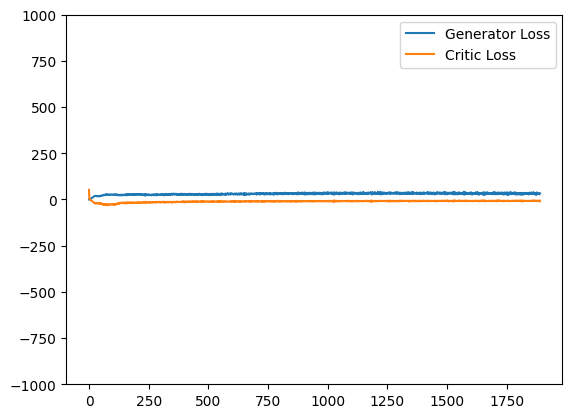

In [ ]:
# Training loop
for epoch in range(n_epochs):
  for real, _ in tqdm(dataloader):
    cur_bs = len(real) #128
    real = real.to(device)

    # Critic
    mean_crit_loss = 0
    for _ in range(crit_cycles):
      crit_opt.zero_grad()

      noise = gen_noise(cur_bs, z_dim)
      fake = gen(noise)
      crit_fake_pred = crit(fake.detach())
      crit_real_pred = crit(real)

      alpha = torch.rand(len(real), 1, 1, 1, device = device, requires_grad=True)
      gp = get_gp(real, fake.detach(), crit, alpha)

      crit_loss = crit_fake_pred.mean() - crit_real_pred.mean() + gp

      mean_crit_loss += crit_loss.item()/crit_cycles
      
      crit_loss.backward(retain_graph = True)
      crit_opt.step()

    crit_losses += [mean_crit_loss]

    # Generator
    gen_opt.zero_grad()
    noise = gen_noise(cur_bs, z_dim)
    fake = gen(noise)
    crit_fake_pred = crit(fake)
    
    gen_loss = -crit_fake_pred.mean()
    gen_loss.backward()
    gen_opt.step()

    gen_losses += [gen_loss.item()]

    # Stats
    if wandbact==1:
      wandb.log({'Epoch': epoch, 'Step': cur_step, 'Critic loss': mean_crit_loss, 'Gen loss': gen_loss})

    if cur_step % save_step == 0 and cur_step > 0:
      print('Saving checkpoint: ', cur_step, save_step)
      save_checkpoint("latest")
    
    if(cur_step % show_step == 0 and cur_step > 0):
      show(fake, wandbactive=1, name='fake')
      show(real, wandbactive=1, name='real')

      gen_mean = sum(gen_losses[-show_step:]) / show_step
      crit_mean = sum(crit_losses[-show_step:])/show_step
      print(f"Epoch: {epoch} : Step {cur_step}: Generator loss: {gen_mean}, Critic loss: {crit_mean}")

      plt.plot(
          range(len(gen_losses)),
          torch.Tensor(gen_losses),
          label = 'Generator Loss'
      )
      
      plt.plot(
          range(len(gen_losses)),
          torch.Tensor(crit_losses),
          label = 'Critic Loss'
      )

      plt.ylim(-1000, 1000)
      plt.legend()
      plt.show()

    cur_step += 1
